# 1. Import Libraries

In [221]:
# Tools
import os
import pandas as pd
import numpy as np
from tqdm import trange
from collections import defaultdict
from scipy import stats
import scipy
import pickle
#from parabolic import parabolic
import math


# Audio file processing
import librosa
from librosa import feature
import librosa.display
from IPython.display import Audio
import IPython
from pydub import AudioSegment

# Visual
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# Modeling
from sklearn.preprocessing import StandardScaler, PolynomialFeatures,MinMaxScaler,MultiLabelBinarizer
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split, GridSearchCV,RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import Pipeline
from lightgbm import LGBMClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.utils.multiclass import unique_labels

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

[Feature Engineering Tools](https://musicinformationretrieval.com/index.html)  
[Imbalanced Class Literature](https://www.svds.com/learning-imbalanced-classes/)  
[MFCC Explanation](http://practicalcryptography.com/miscellaneous/machine-learning/guide-mel-frequency-cepstral-coefficients-mfccs/)
* If we just want to classify some sound, we should build features that are speaker independent. Any feature that only gives information about the speaker (like the pitch of their voice) will not be helpful for classification. In other words, we should extract features that depend on the "content" of the audio rather than the nature of the speaker. Also, a good feature extraction technique should mimic the human speech perception. We don't hear loudness on a linear scale. If we want to double the perceived loudness of a sound, we have to put 8 times as much energy into it. Instead of a linear scale, our perception system uses a log scale. Taking these things into account, Davis and Mermelstein came up with MFCC in the 1980's. MFCC mimics the logarithmic perception of loudness and pitch of human auditory system and tries to eliminate speaker dependent characteristics by excluding the fundamental frequency and their harmonics. The underlying mathematics is quite complicated and we will skip that. For those interested, here is the detailed explanation.  

[MFCC Librosa Implementation](https://librosa.github.io/librosa/generated/librosa.feature.mfcc.html)  
[Sound Augmentation - Kaggle](https://www.kaggle.com/huseinzol05/sound-augmentation-librosa)  
[Fourier Transformation](https://musicinformationretrieval.com/fourier_transform.html)  
[Frequency Cutoff Based on intelligibility : ~10k Hz](https://www.dpamicrophones.com/mic-university/facts-about-speech-intelligibility)  
[Someone implemented gender classification in Python 2](https://appliedmachinelearning.blog/2017/06/14/voice-gender-detection-using-gmms-a-python-primer/)  
[Voice Normalization Tips : Peak vs RMS](https://www.learndigitalaudio.com/normalize-audio)  
[FFT VS RFFT](https://stackoverflow.com/questions/52387673/what-is-the-difference-between-numpy-fft-fft-and-numpy-fft-rfft/52388007)


* Do one feature engineering, and plot that feature to see if it helps classify different classes as whon here [Link](https://musicinformationretrieval.com/basic_feature_extraction.html)

# 3. Load Data

In [3]:
# Load RAVDESS
# Load audio file names
data_folder_list = os.listdir('data/')
if '.DS_Store' in data_folder_list:
    data_folder_list.remove('.DS_Store')
data = []
for folder in data_folder_list:
    files = os.listdir('data/'+folder)
    for file in files:
        data.append('data/'+folder+'/'+file)

# Create pandas dataframe for all files
emotion_mapping = {1:'neutral',2:'calm',3:'happy',4:'sad',5:'angry',6:'fearful',7:'disgust',8:'surprised'}
gender_mapping = {0:'female',1:'male'}
df_ravdess = pd.DataFrame({
                   'filename':data,
                   'dataset':['ravdess']*len(data),
                   'emotion':[int(x.split('-')[2]) for x in data],
                   'emotion_desc':[emotion_mapping[int(x.split('-')[2])] for x in data],
                   'emotion_intensity':[int(x.split('-')[3]) for x in data],
                   'statement':[int(x.split('-')[4]) for x in data],
                   'repetition':[int(x.split('-')[5]) for x in data],
                   'actor':[int(x.split('-')[6].split('.')[0]) for x in data],    
                   'gender' :[gender_mapping[int(x.split('-')[0][-5:-3])%2] for x in data]
                  
                  })

# Load TESS
# Load audio file names
file_list = os.listdir('data_tess/')
if '.DS_Store' in file_list:
    file_list.remove('.DS_Store')
data = []
for file in file_list:
    data.append('data_tess/'+file)

# Create pandas dataframe for all files
emotion_mapping = {'neutral':'neutral','angry':'angry','happy':'happy',
                   'sad':'sad','angry':'angry','fear':'fearful','disgust':'disgust','ps':'surprised'}
gender_mapping = {'OA':'male','OAF':'male','YAF':'female'}
df_tess = pd.DataFrame({
                   'filename':data,
                   'dataset':['tess']*len(data),
                   'gender':[gender_mapping[x.split('/')[1].split('_')[0]] for x in data],
                   'emotion_desc':[emotion_mapping[x.split('/')[1].split('_')[2].split('.')[0]] for x in data]
                  
                  })



# Combine two dataframes
df_combined = pd.concat([df_ravdess[df_tess.columns], df_tess], axis=0).reset_index()
df_combined.drop(['index'],inplace=True,axis=1)

# Data Preprocessing

In [291]:
# Strip silence at the beginning and end of a signal
def strip(signal, frame_length=512, hop_length=256):

    # Compute RMSE.
    rmse = librosa.feature.rms(signal, frame_length=frame_length, hop_length=hop_length, center=True)
    
    # Identify the first frame index where RMSE exceeds a threshold.
    thresh = 0.001
    frame_index = 0
    while rmse[0][frame_index] < thresh:
        frame_index += 1
        
    # Convert units of frames to samples.
    start_sample_index = librosa.frames_to_samples(frame_index, hop_length=hop_length)
    
    signal = signal[start_sample_index:]    
    signal = np.array(list(signal)[::-1])
    
    # Compute RMSE.
    rmse = librosa.feature.rms(signal, frame_length=frame_length, hop_length=hop_length, center=True)
    
    # Identify the first frame index where RMSE exceeds a threshold.
    thresh = 0.001
    frame_index = 0
    while rmse[0][frame_index] < thresh:
        frame_index += 1
        
    # Convert units of frames to samples.
    start_sample_index = librosa.frames_to_samples(frame_index, hop_length=hop_length)
      
    signal = np.array(signal[start_sample_index:])
    
    # Return the trimmed signal.
    return np.array(list(signal)[::-1])


# Fourier Transformation. Link : https://musicinformationretrieval.com/fourier_transform.html
# It transforms our time-domain signal into the frequency domain. Whereas the time domain expresses our signal as a sequence of samples, the frequency domain expresses our signal as a superposition of sinusoids of varying magnitudes, frequencies, and phase offsets.
def rfft(signal):
    return abs(scipy.fftpack.rfft(abs(signal)))

def rfft_clip(signal,min_freq,max_freq,sr):
    freq = np.fft.rfftfreq(len(signal), d=1./sr)
    return abs(np.fft.rfft((signal)))[(freq>min_freq) & (freq<max_freq)]


def fft(signal):
    return scipy.fft(signal)

# I want to normalize in hope of taking gender out of voice
def normalize(signal):
    return librosa.util.normalize(signal)

def min_max_scale(signal):
    scaler = MinMaxScaler(feature_range=(-1,1))
    return scaler.fit_transform(np.array(signal).reshape(-1,1)).reshape(-1)

def spectral_centroid(signal,sr):
    return librosa.feature.spectral_centroid(signal,sr=sr)[0]

# Get length of voice
def seconds(signal):
    return librosa.get_duration(signal)

# Returns total number of times signal crossed zero. It will return 0 if I removed signal below threshold
def zero_crossings(signal):
    return sum(librosa.zero_crossings(signal))

def freq_from_zero_crossings(signal):
    return zero_crossings(signal)/seconds(signal)

# Bucket_size while not losing information by extracting features : std, mean, max, min
def compress_data_and_extract_features(data,bucket_size):
    data_bucket_std = []
    data_bucket_mean = []
    data_bucket_percentile_0 = []
    data_bucket_percentile_1 = []
    data_bucket_percentile_25 = []
    data_bucket_percentile_50 = []
    data_bucket_percentile_75 = []
    data_bucket_percentile_99 = []
    data_bucket_percentile_100 = []
        
    for j in range(0,data.shape[0],bucket_size):
        data_bucket_std.append(abs(data[j:(j+bucket_size)]).std())
        data_bucket_mean.append(abs(data[j:(j+bucket_size)]).mean())
        holder_percentile=np.percentile(abs(data[j:(j+bucket_size)]),[0, 1,25,50,75, 99, 100])
        data_bucket_percentile_0.append(holder_percentile[0])
        data_bucket_percentile_1.append(holder_percentile[1])
        data_bucket_percentile_25.append(holder_percentile[2])
        data_bucket_percentile_50.append(holder_percentile[3])
        data_bucket_percentile_75.append(holder_percentile[4])
        data_bucket_percentile_99.append(holder_percentile[5])
        data_bucket_percentile_100.append(holder_percentile[6])

    
    return np.array(data_bucket_std+data_bucket_mean+data_bucket_percentile_0+data_bucket_percentile_1+data_bucket_percentile_25+data_bucket_percentile_50+data_bucket_percentile_75+data_bucket_percentile_99+data_bucket_percentile_100)
    #return np.array(data_bucket_std+data_bucket_mean+data_bucket_percentile_90+data_bucket_percentile_99+data_bucket_percentile_100)
def extract_max(pitches,magnitudes, shape):
    new_pitches = []
    new_magnitudes = []
    for i in range(0, shape[1]):
        new_pitches.append(np.max(pitches[:,i]))
        new_magnitudes.append(np.max(magnitudes[:,i]))
    return (new_pitches,new_magnitudes)



In [287]:
def df_preprocess(df):
    n_fft = 512
    hop_length = 256
    
    
    stripped = []
    mfcc = []
    rmsed = []
    pitch_list = []
    pitch_mag_list = []
    pitch_stat_from_rms = []
    
    
    for i in trange(len(df['filename'])):
        # Empty holder for data for efficiency memory
        stripped_holder,ffted_holder=[],[]               
        
        
        # Load file as signal & strip the silences at the beginning and at the end
        signal,sr = librosa.load(df['filename'].iloc[i],res_type='kaiser_fast') 
        signal = strip(signal)
        stripped.append(signal)   
        
        # Get pitches & Magnitudes
        pitch, magnitude = librosa.core.piptrack(y=signal, sr=22050, n_fft=n_fft, hop_length=hop_length, fmin=50, fmax=380, threshold=0.0001, win_length=None, window='hann', center=True, pad_mode='reflect', ref=None)
        pitches,magnitudes = extract_max(pitch,magnitude,pitch.shape)
        pitches = [x for x in pitches if x>0]
        pitch_list.append(compress_data_and_extract_features(np.array(pitches),len(pitches)))
        pitch_mag_list.append(compress_data_and_extract_features(np.array(magnitudes),len(magnitudes)))

        # 20 Mfcc features
        mfcc.append(np.mean(librosa.feature.mfcc(signal, sr=sr),axis=1))

        # Get rms
        rms = librosa.feature.rms(y=signal,frame_length=n_fft,hop_length=hop_length)[0]
        rmsed.append(compress_data_and_extract_features(np.array(rms),len(rms)))
        
        # Get top strongest RMS segments of audio file.
        top_idx = np.argsort(rms)[-8:]
        mean_freq_list = []
        # Iterate through each strong rms segments to extract pitches
        for ix,index in enumerate(top_idx):
            max_rms_frame_start = int(index/len(rms)*len(signal)-n_fft*2)
            max_rms_frame_stop = int(index/len(rms)*len(signal)+n_fft*2)
            audio_strongest_rms = signal[max_rms_frame_start:max_rms_frame_stop]
            # Auto correlate the audio in hope of removing noise and getting fundamental frequencyu
            signal_autocorr = librosa.autocorrelate(audio_strongest_rms)
            # Get pitch and magnitude of each segment
            if list(signal_autocorr):
                pitch_rms, _ = librosa.core.piptrack(y=signal_autocorr, sr=22050, n_fft=n_fft, hop_length=hop_length, fmin=50, fmax=380, threshold=0.0001, win_length=None, window='hann', center=True, pad_mode='reflect', ref=None)
                freq_list_holder = []
                for i in range(len(pitch_rms)):            
                    freq_list_holder+=list(pitch_rms[i])
                mean_freq_list.append(np.mean([x for x in freq_list_holder if x>0])) 
        pitch_stat_from_rms_holder = []
        pitch_stat_from_rms_holder.append(np.mean(mean_freq_list))
        pitch_stat_from_rms_holder.append(np.std(mean_freq_list))
        pitch_stat_from_rms_holder.append(np.min(mean_freq_list))
        pitch_stat_from_rms_holder.append(np.max(mean_freq_list))
        pitch_stat_from_rms.append(np.array(pitch_stat_from_rms_holder))

        
    df['stripped']= stripped
    df['mfcc']= mfcc
    df['rmsed']= rmsed
    df['pitch_list']= pitch_list
    df['pitch_mag_list']=pitch_mag_list
    df['pitch_stat_from_rms'] = pitch_stat_from_rms
    return df

df_combined_processed = df_preprocess(df_combined).copy()
with open('df_combined_processed_rms_pitch.pkl', 'wb') as picklefile:
    pickle.dump(df_combined_processed, picklefile)

  0%|          | 2/4240 [00:00<18:54,  3.74it/s]


ValueError: zero-size array to reduction operation maximum which has no identity

# 4. Feature Engineering

### Feature Engineering Playground

### Pitch&Magnitude Detection

In [453]:
mask_ravdess_female = ((df_combined['dataset']=='ravdess')&(df_combined['gender']=='female')&(df_combined['emotion_desc']=='neutral'))
mask_ravdess_male = ((df_combined['dataset']=='ravdess')&(df_combined['gender']=='male')&(df_combined['emotion_desc']=='neutral'))
mask_tess_female = ((df_combined['dataset']=='tess')&(df_combined['gender']=='female'))
mask_tess_male = ((df_combined['dataset']=='tess')&(df_combined['gender']=='male'))

In [1275]:
def pitch_detector(data,n_fft,hop_length,fmin,fmax,threshhold,male_female):
    for i in range(len(data)):
        signal,sr = librosa.load(data['filename'].iloc[i],res_type='kaiser_fast')
        pitch, magnitude = librosa.core.piptrack(y=strip(signal), sr=22050, n_fft=n_fft, hop_length=hop_length, fmin=fmin, fmax=fmax, threshold=threshhold, win_length=None, window='hann', center=True, pad_mode='reflect', ref=None)

        pitches,magnitudes = extract_max(pitch,magnitude,pitch.shape)
        pitches = np.array([x for x in pitches if x>0])

#         plt.subplot(len(data)+1,1,i+1)
#         plt.plot(pitches[pitches>0]);
        plt.plot(compress_data_and_extract_features(pitches,len(pitches))[1:])
        plt.title(male_female)

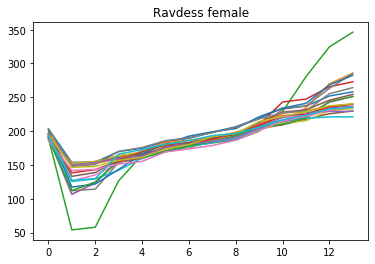

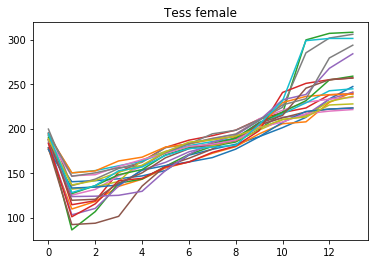

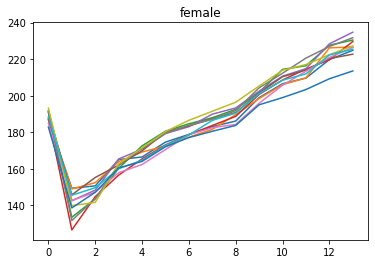

_______________________


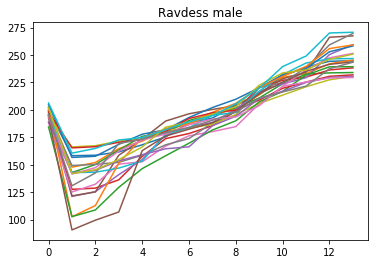

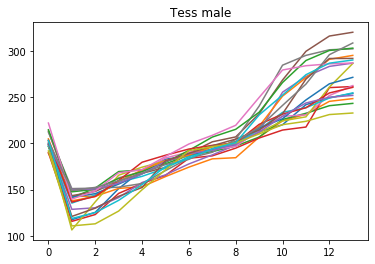

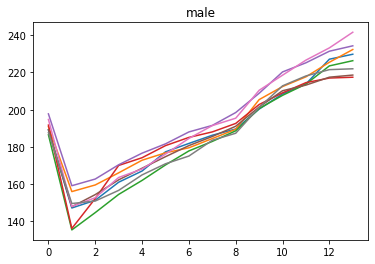

In [1276]:
bin_n = 2048
hop_length = int(bin_n/2)
min_f = 40
max_f = 350
ratio = 0.001

pitch_detector(df_combined[mask_ravdess_female][:20],bin_n,hop_length,min_f,max_f,ratio,'Ravdess female')
plt.show()
pitch_detector(df_combined[mask_tess_female][:20],bin_n,hop_length,min_f,max_f,ratio,'Tess female')
plt.show()
pitch_detector(df_test_processed_female,bin_n,hop_length,min_f,max_f,ratio,'female')
plt.show()
print('_______________________')
pitch_detector(df_combined[mask_ravdess_male][:20],bin_n,hop_length,min_f,max_f,ratio,'Ravdess male')
plt.show()
pitch_detector(df_combined[mask_tess_male][:20],bin_n,hop_length,min_f,max_f,ratio,'Tess male')
plt.show()
pitch_detector(df_test_processed_male,bin_n,hop_length,min_f,max_f,ratio,'male')

#### Load test data for Pitch&Magnitude Detection section

In [489]:
formats_to_convert = ['.m4a']
# test_data youtube_test
folder = "test_data/"

for (dirpath, dirnames, filenames) in os.walk(folder):
    for filename in filenames:
        if filename.endswith(tuple(formats_to_convert)):

            filepath = dirpath + '/' + filename
            (path, file_extension) = os.path.splitext(filepath)
            file_extension_final = file_extension.replace('.', '')
            try:
                track = AudioSegment.from_file(filepath,
                        file_extension_final)
                wav_filename = filename.replace(file_extension_final, 'wav')
                wav_path = dirpath + '/' + wav_filename
                print('CONVERTING: ' + str(filepath))
                file_handle = track.export(wav_path, format='wav')
                os.remove(filepath)
            except:
                print("ERROR CONVERTING " + str(filepath))
def process_test_data():
    # Load files to test
    test_data_folder_list = os.listdir(folder)
    if '.DS_Store' in test_data_folder_list:
        test_data_folder_list.remove('.DS_Store')
    test_data_folder_list = [folder+x for x in test_data_folder_list]

    # Create dataframe for test data
    df_test = pd.DataFrame({'filename':test_data_folder_list})

    # Process df_test and create ffted,mfcc,and etc...
    df_test_processed = df_preprocess(df_test)

    # Get features from df_test_processed
    X_test_mfcc = pd.DataFrame(list(df_test_processed['mfcc']))
    X_test_ffted_compressed = pd.DataFrame(list(df_test_processed['rffted_comp']))
    X_test_mfcc_ffted = pd.concat([X_test_mfcc, X_test_ffted_compressed], axis=1)

    # For X_real_test, choose one of the top
    test_gender = X_test_ffted_compressed
    test_class = X_test_mfcc_ffted
    return test_gender,test_class,df_test_processed

def predict_gender_and_emotion(model_gender,model_class,model_male_class,model_female_class,data_gender, data_class,df_test_processed,gender_specific = True):
    pred_gender = model_gender.predict(data_gender)
    pred_gender_proba = model_gender.predict_proba(data_gender)
    pred_class = []
    for ix in range(len(data_class)):
        if gender_specific==True:
            if pred_gender[ix]=='male':
                pred_class.append(model_male_class.predict(data_class.iloc[[ix]]))
            else:
                pred_class.append(model_female_class.predict(data_class.iloc[[ix]]))
        else:
             pred_class.append(model_class.predict(data_class.iloc[[ix]]))
    for i in range(len(df_test_processed)):
        print('{}[{}] : {} - {}'.format(pred_gender[i],pred_gender_proba[i],pred_class[i],df_test_processed['filename'][i].split('/')[1].split('.')[0]))
        IPython.display.display(Audio(df_test_processed['stripped'][i],rate=22050))
        print('____________________')
        
test_gender,test_class,df_test_processed_male = process_test_data()


100%|██████████| 8/8 [00:02<00:00,  2.92it/s]


#### Find frame of strongest energy

In [470]:
def pitch_from_energe(mask,index):
    file_name = df_combined[mask]['filename'].iloc[index]
    signal,sr = librosa.load(file_name,res_type='kaiser_fast')
    signal = strip(signal)
    n_fft = 1024
    hop_length = 512
    
    # Get rms
    rms = librosa.feature.rms(y=signal,frame_length=n_fft,hop_length=hop_length)[0] 
    # Get pitches & Magnitudes
    pitch, magnitude = librosa.core.piptrack(y=signal, sr=22050, n_fft=n_fft, hop_length=hop_length, fmin=50, fmax=400, win_length=None, window='hann', center=True, pad_mode='reflect', ref=None)
    pitches,magnitudes = extract_max(pitch,magnitude,pitch.shape)
    

#     # Original Audio
#     plt.figure(figsize=(4, 2))
#     plt.plot(signal)
#     plt.title('Original Audio')
#     plt.show()
    IPython.display.display(Audio((signal),rate=sr))
#     # Graph rms
#     plt.figure(figsize=(4, 2)) 
#     plt.plot(rms)
#     plt.title('RMS')
#     #Pitches Graph
#     plt.figure(figsize=(4, 2)) 
#     plt.plot(pitches)
#     plt.title('Pitches')
#     plt.show()
#     # Pitches' Magnitude Graph
#     plt.figure(figsize=(4, 2)) 
#     plt.plot(magnitudes)
#     plt.title('Magnitude')
#     plt.show()

    # Get top strongest RMS segments of audio file.
    top_idx = np.argsort(rms)[:50]
    mean_freq_list = []
    perc5_freq_list = []    
    perc25_freq_list = []
    perc50_freq_list = []

    perc75_freq_list = []
    
    # Iterate through each strong rms segments to extract pitches
    for ix,index in enumerate(top_idx):
        max_rms_frame_start = int(index/len(rms)*len(signal)-n_fft/2)
        max_rms_frame_stop = int(index/len(rms)*len(signal)+n_fft/2)
        audio_strongest_rms = signal[max_rms_frame_start:max_rms_frame_stop]
        # Auto correlate the audio in hope of removing noise and getting fundamental frequencyu
        sigal_autocorr = librosa.autocorrelate(audio_strongest_rms)
        # Get pitch and magnitude of each segment
        if list(audio_strongest_rms):
            pitch_rms, magnitude_rms = librosa.core.piptrack(y=audio_strongest_rms, sr=22050, n_fft=n_fft, hop_length=hop_length, fmin=50, fmax=400, win_length=None, window='hann', center=True, pad_mode='reflect', ref=None)
            freq_list_holder = []
            for i in range(len(pitch_rms)):            

                freq_list_holder+=list(pitch_rms[i])
            mean_freq_list.append(np.mean([x for x in freq_list_holder if x>0]))        
 
    mean_freq_list = [x for x in mean_freq_list if x>0]    
    counts,value = np.histogram(mean_freq_list,bins=15)
    
    #print("List : ",mean_freq_list)
    print("Mean : ",np.mean(mean_freq_list))
    print("Std : ",np.std(mean_freq_list))
    print("Min : ",np.min(mean_freq_list))
    print("Max : ",np.max(mean_freq_list))
    print("Mode : ",value[np.argmax(counts)])

    #print("5 : ",perc5_freq_list)   
    #print("25 : ",perc25_freq_list)
    #print("50 : ",perc50_freq_list)
    #print("75 : ",perc75_freq_list)

    
    
    
    

##### Auoto Correlate

In [471]:
for i in range(10):
    pitch_from_energe(mask_ravdess_female,i)
    print('____________________')

Mean :  244.4539
Std :  19.532516
Min :  209.76111
Max :  280.03503
Mode :  228.50082
____________________


Mean :  240.57912
Std :  21.606037
Min :  181.67842
Max :  288.06506
Mode :  259.69528
____________________


Mean :  250.3632
Std :  20.406271
Min :  207.49799
Max :  292.6972
Mode :  241.57767
____________________


Mean :  240.23811
Std :  20.408432
Min :  202.7913
Max :  286.184
Mode :  241.70789
____________________


Mean :  248.50287
Std :  16.739586
Min :  206.09976
Max :  281.02313
Mode :  236.0691
____________________


Mean :  250.20528
Std :  18.749205
Min :  214.00906
Max :  278.87067
Mode :  265.89835
____________________


Mean :  251.64555
Std :  16.820597
Min :  209.26297
Max :  286.41235
Mode :  255.5526
____________________


Mean :  253.58357
Std :  17.184868
Min :  210.83618
Max :  288.811
Mode :  247.22443
____________________


Mean :  259.573
Std :  33.29318
Min :  198.48994
Max :  341.49078
Mode :  255.69028
____________________


Mean :  255.39832
Std :  30.074003
Min :  204.00269
Max :  337.9108
Mode :  248.63872
____________________


In [472]:
for i in range(10):
    pitch_from_energe(mask_ravdess_male,i)
    print('____________________')

Mean :  218.80086
Std :  15.67465
Min :  186.11082
Max :  253.37852
Mode :  204.04887
____________________


Mean :  215.78355
Std :  15.698753
Min :  178.64665
Max :  242.0728
Mode :  216.70235
____________________


Mean :  219.70831
Std :  20.620672
Min :  138.90938
Max :  247.70107
Mode :  218.68994
____________________


Mean :  228.12138
Std :  15.233744
Min :  186.9216
Max :  248.64622
Mode :  223.95638
____________________


Mean :  220.8419
Std :  11.262287
Min :  197.7481
Max :  240.44635
Mode :  229.06015
____________________


Mean :  220.78479
Std :  15.58323
Min :  178.08578
Max :  247.95833
Mode :  215.35114
____________________


Mean :  218.12
Std :  17.279978
Min :  177.02022
Max :  268.2406
Mode :  219.58974
____________________


Mean :  217.67381
Std :  16.769304
Min :  182.55188
Max :  259.87418
Mode :  213.4808
____________________


Mean :  229.64507
Std :  15.394503
Min :  197.13101
Max :  272.7456
Mode :  237.4588
____________________


Mean :  227.90149
Std :  16.764349
Min :  180.6374
Max :  262.71283
Mode :  224.41096
____________________


### w/e 2

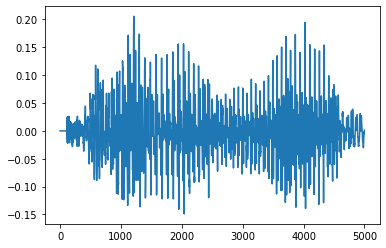

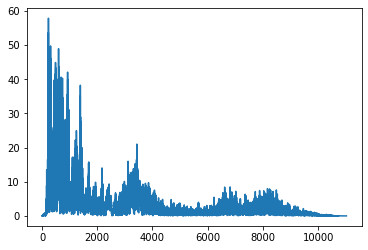

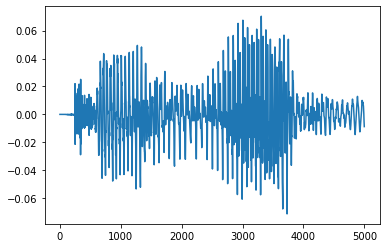

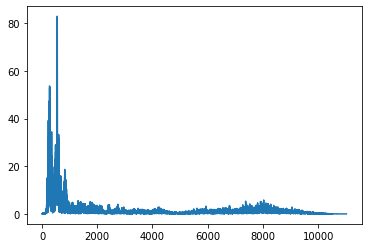

In [888]:
for i in range(2):
    signal,sr = librosa.load(df_combined['filename'].iloc[i],res_type='kaiser_fast')
    signal = strip(signal)
    plt.plot(signal[0:5000])
    plt.show()
    #signal = abs((signal))
    #plt.plot(signal[0:1000])
    #plt.show()
    freq = np.fft.rfftfreq(len(signal), d=1./sr)
    plt.plot(freq,abs(np.fft.rfft((signal))))
    #plt.plot(freq[(freq>30) & (freq<1000)],abs(np.fft.rfft((signal)))[(freq>30) & (freq<1000)])
    plt.show()


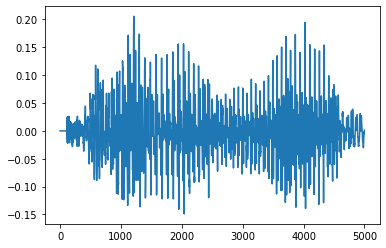

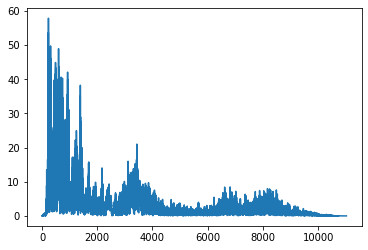

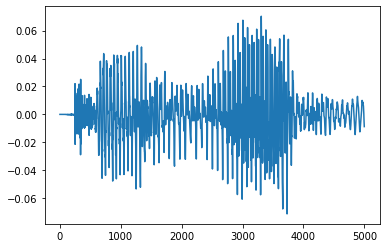

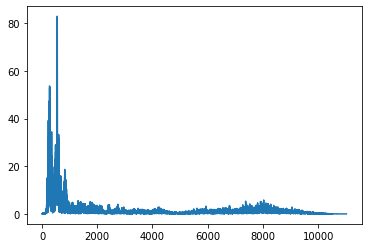

In [889]:
for i in range(2):
    signal,sr = librosa.load(df_combined['filename'].iloc[i],res_type='kaiser_fast')
    signal = strip(signal)
    plt.plot(signal[0:5000])
    plt.show()
    #signal = abs((signal))
    #plt.plot(signal[0:1000])
    #plt.show()
    freq = np.fft.rfftfreq(len(signal), d=1./sr)
    plt.plot(freq,abs(np.fft.rfft((signal))))
    #plt.plot(freq[(freq>30) & (freq<1000)],abs(np.fft.rfft((signal)))[(freq>30) & (freq<1000)])
    plt.show()



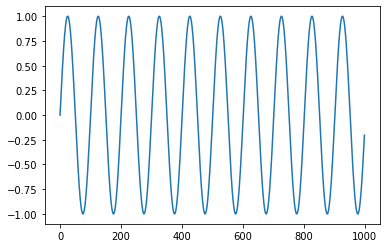

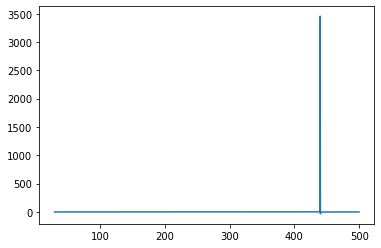

In [48]:
import numpy as np
from scipy.io import wavfile

sampleRate = 44100
frequency = 440
length = 5

t = np.linspace(0, length, sampleRate * length)  #  Produces a 5 second Audio-File
y = np.sin(frequency * 2 * np.pi * t)  #  Has frequency of 440Hz
plt.plot(y[:1000])
plt.show()

freq = np.fft.rfftfreq(len(y), d=1./sampleRate)
plt.plot(freq[(freq>30) & (freq<500)],np.fft.rfft(y)[(freq>30) & (freq<500)])

In [79]:
male_mask = df_combined_processed['gender']=='male'
female_mask = df_combined_processed['gender']=='female'

In [8]:
# for ix,file in enumerate(df_combined_processed[male_mask]['stripped'][:5]):
#     IPython.display.display(Audio((file),rate=sr))
#     #f_occurence = abs(scipy.fftpack.rfft(abs(file)))[40:]
#     plt.plot( abs(scipy.fftpack.rfft(abs(file) ))[:1000])
#     plt.show()


 25%|██▌       | 1/4 [00:00<00:00,  6.15it/s]

22050
22050



 50%|█████     | 2/4 [00:00<00:00,  6.22it/s]

22050



100%|██████████| 4/4 [00:01<00:00,  2.35it/s]

22050


/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/ipykernel_launcher.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/ipykernel_launcher.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documen

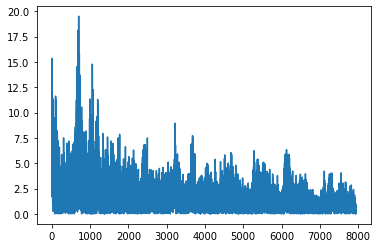

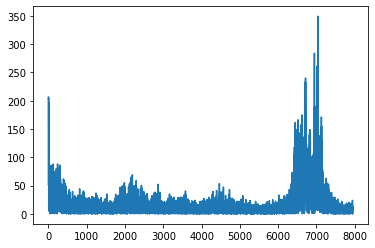

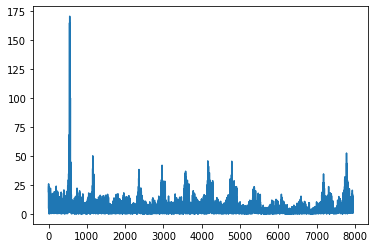

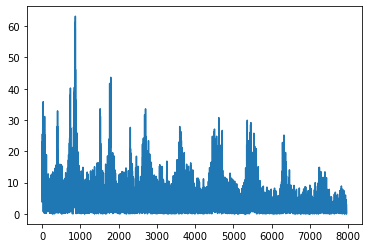

In [77]:
formats_to_convert = ['.m4a']
# test_data youtube_test
folder = "test_data/"

for (dirpath, dirnames, filenames) in os.walk(folder):
    for filename in filenames:
        if filename.endswith(tuple(formats_to_convert)):

            filepath = dirpath + '/' + filename
            (path, file_extension) = os.path.splitext(filepath)
            file_extension_final = file_extension.replace('.', '')
            try:
                track = AudioSegment.from_file(filepath,
                        file_extension_final)
                wav_filename = filename.replace(file_extension_final, 'wav')
                wav_path = dirpath + '/' + wav_filename
                print('CONVERTING: ' + str(filepath))
                file_handle = track.export(wav_path, format='wav')
                os.remove(filepath)
            except:
                print("ERROR CONVERTING " + str(filepath))
def process_test_data():
    # Load files to test
    test_data_folder_list = os.listdir(folder)
    if '.DS_Store' in test_data_folder_list:
        test_data_folder_list.remove('.DS_Store')
    test_data_folder_list = [folder+x for x in test_data_folder_list]

    # Create dataframe for test data
    df_test = pd.DataFrame({'filename':test_data_folder_list})

    # Process df_test and create ffted,mfcc,and etc...
    df_test_processed = df_preprocess(df_test[0:4])


    for ix,file in enumerate(df_test_processed['stripped']):
        IPython.display.display(Audio((file),rate=sr))
        f_occurence = abs(scipy.fftpack.rfft(abs(df_test_processed['stripped'].iloc[ix])))[50:8000]
        plt.plot(f_occurence)
        plt.show()
process_test_data()

### Various Processing & Feature Functions

In [140]:
# Strip silence at the beginning and end of a signal
def strip(signal, frame_length=512, hop_length=256):

    # Compute RMSE.
    rmse = librosa.feature.rms(signal, frame_length=frame_length, hop_length=hop_length, center=True)
    
    # Identify the first frame index where RMSE exceeds a threshold.
    thresh = 0.001
    frame_index = 0
    while rmse[0][frame_index] < thresh:
        frame_index += 1
        
    # Convert units of frames to samples.
    start_sample_index = librosa.frames_to_samples(frame_index, hop_length=hop_length)
    
    signal = signal[start_sample_index:]    
    signal = np.array(list(signal)[::-1])
    
    # Compute RMSE.
    rmse = librosa.feature.rms(signal, frame_length=frame_length, hop_length=hop_length, center=True)
    
    # Identify the first frame index where RMSE exceeds a threshold.
    thresh = 0.001
    frame_index = 0
    while rmse[0][frame_index] < thresh:
        frame_index += 1
        
    # Convert units of frames to samples.
    start_sample_index = librosa.frames_to_samples(frame_index, hop_length=hop_length)
      
    signal = np.array(signal[start_sample_index:])
    
    # Return the trimmed signal.
    return np.array(list(signal)[::-1])


# Fourier Transformation. Link : https://musicinformationretrieval.com/fourier_transform.html
# It transforms our time-domain signal into the frequency domain. Whereas the time domain expresses our signal as a sequence of samples, the frequency domain expresses our signal as a superposition of sinusoids of varying magnitudes, frequencies, and phase offsets.
def rfft(signal):
    return abs(scipy.fftpack.rfft(abs(signal)))

def rfft_clip(signal,min_freq,max_freq,sr):
    freq = np.fft.rfftfreq(len(signal), d=1./sr)
    return abs(np.fft.rfft((signal)))[(freq>min_freq) & (freq<max_freq)]


def fft(signal):
    return scipy.fft(signal)

# I want to normalize in hope of taking gender out of voice
def normalize(signal):
    return librosa.util.normalize(signal)

def min_max_scale(signal):
    scaler = MinMaxScaler(feature_range=(-1,1))
    return scaler.fit_transform(np.array(signal).reshape(-1,1)).reshape(-1)

def spectral_centroid(signal,sr):
    return librosa.feature.spectral_centroid(signal,sr=sr)[0]

# Get length of voice
def seconds(signal):
    return librosa.get_duration(signal)

# Returns total number of times signal crossed zero. It will return 0 if I removed signal below threshold
def zero_crossings(signal):
    return sum(librosa.zero_crossings(signal))

def freq_from_zero_crossings(signal):
    return zero_crossings(signal)/seconds(signal)

# Bucket_size while not losing information by extracting features : std, mean, max, min
def compress_data_and_extract_features(data,bucket_size):
    data_bucket_std = []
    data_bucket_mean = []
    data_bucket_percentile_0 = []
    data_bucket_percentile_1 = []
    data_bucket_percentile_25 = []
    data_bucket_percentile_50 = []
    data_bucket_percentile_75 = []
    data_bucket_percentile_99 = []
    data_bucket_percentile_100 = []
        
    for j in range(0,data.shape[0],bucket_size):
        data_bucket_std.append(abs(data[j:(j+bucket_size)]).std())
        data_bucket_mean.append(abs(data[j:(j+bucket_size)]).mean())
        holder_percentile=np.percentile(abs(data[j:(j+bucket_size)]),[0, 1,25,50,75, 99, 100])
        data_bucket_percentile_0.append(holder_percentile[0])
        data_bucket_percentile_1.append(holder_percentile[1])
        data_bucket_percentile_25.append(holder_percentile[2])
        data_bucket_percentile_50.append(holder_percentile[3])
        data_bucket_percentile_75.append(holder_percentile[4])
        data_bucket_percentile_99.append(holder_percentile[5])
        data_bucket_percentile_100.append(holder_percentile[6])

    
    return np.array(data_bucket_std+data_bucket_mean+data_bucket_percentile_0+data_bucket_percentile_1+data_bucket_percentile_25+data_bucket_percentile_50+data_bucket_percentile_75+data_bucket_percentile_99+data_bucket_percentile_100)
    #return np.array(data_bucket_std+data_bucket_mean+data_bucket_percentile_90+data_bucket_percentile_99+data_bucket_percentile_100)
def extract_max(pitches,magnitudes, shape):
    new_pitches = []
    new_magnitudes = []
    for i in range(0, shape[1]):
        new_pitches.append(np.max([x for x in pitches[:,i]]))
        new_magnitudes.append(np.max(magnitudes[:,i]))
    return (new_pitches,new_magnitudes)


#### Create df_features Troubleshoot

Feature Shape :  (20,)
Feature :  [-211.07695     71.65225    -27.994196    16.111143   -30.187593
  -17.543785   -15.172415   -15.263143   -26.10121      8.258981
  -24.340408    -1.7681133   -6.578144    -8.453528   -11.047208
   -9.887392   -12.484519    -2.9434175   -6.3792024    3.3491395]
Extracted Feature :  [44.968906, 26.329636, 1.7681132555007935, 1.99142107129097, 7.83877158164978, 13.828466892242432, 24.780608654022217, 184.58625747680648, 211.0769500732422]


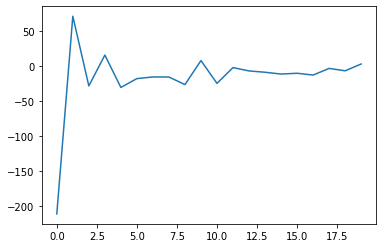

In [154]:
index=3

feature_list = []
hop_length = 256
frame_length = 512
sr = 22050

#signal = raw_files['signal'][index]
signal = raw_files['signal_norm_trimmed'][index]

feature = np.mean(librosa.feature.mfcc(signal, sr=sr),axis=1)
feature_list+=compress_data_and_extract_features(feature,feature.shape[0])

plt.plot(feature)
print("Feature Shape : ",feature.shape)
print("Feature : ",feature)
print("Extracted Feature : ",feature_list)

# 6. EDA

### Target Distribution

It's pretty evenly distributed between 2 Genders


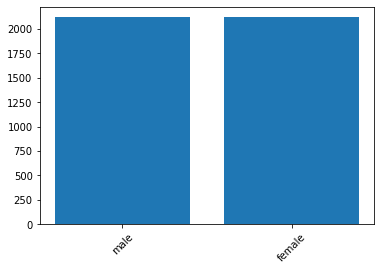

In [18]:
# Gender Binary Classification Target Distribution
target_pcts = df_combined_processed['gender'].value_counts(normalize=False) 
plt.bar(list(target_pcts.index),target_pcts)
plt.xticks(rotation=45)
print("It's pretty evenly distributed between 2 Genders")

Calm is 1/3 of most others. Calm and Neutral are pretty similar, so we'll add them


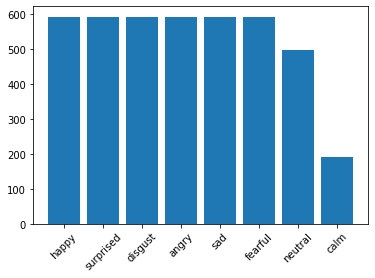

In [20]:
# Multiclass Target Distribution
target_pcts = df_combined_processed['emotion_desc'].value_counts(normalize=False) 
plt.bar(list(target_pcts.index),target_pcts)
plt.xticks(rotation=45)
print("Calm is 1/3 of most others. Calm and Neutral are pretty similar, so we'll add them")


### Pair-lot

/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/statsmodels/nonparametric/kde.py:487: RuntimeWarning: invalid value encountered in true_divide
  binned = fast_linbin(X, a, b, gridsize) / (delta * nobs)
/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/statsmodels/nonparametric/kdetools.py:34: RuntimeWarning: invalid value encountered in double_scalars
  FAC1 = 2*(np.pi*bw/RANGE)**2


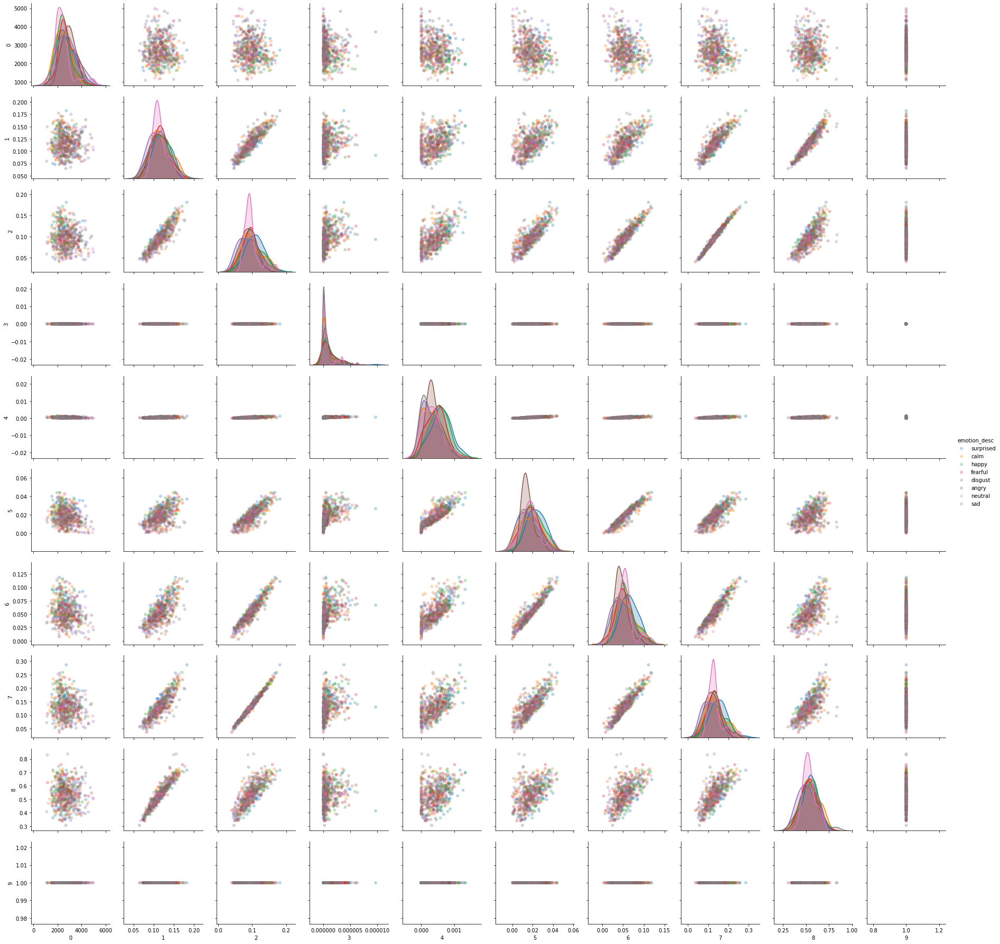

In [100]:
# From 'feature_engineering_instacart' notebook
def plot_features(df, sample_size=500):
    feature_columns = list(df.columns[8:])
    feature_columns.append('emotion_desc')    
    sample = df[feature_columns].sample(sample_size, random_state=44) 
    sns.pairplot(sample,hue='emotion_desc', plot_kws=dict(alpha=.3, edgecolor='none'))

plot_features(df_merged)

### Feature vs Target

In [ ]:
df_features_explore = df_features.copy()
df_features_explore['emotion']=df[df['actor']==1]['emotion_desc'].reset_index()['emotion_desc']
# View values vs target
df_features_explore[:10]

### Visualize Signals & Play Sound

    * Emotion (01 = neutral, 02 = calm, 03 = happy, 04 = sad, 05 = angry, 06 = fearful, 07 = disgust, 08 = surprised).
    * Emotional intensity (01 = normal, 02 = strong). NOTE: There is no strong intensity for the 'neutral' emotion.
    * Statement (01 = "Kids are talking by the door", 02 = "Dogs are sitting by the door").
    * Repetition (01 = 1st repetition, 02 = 2nd repetition).
    * Actor (01 to 24. Odd numbered actors are male, even numbered actors are female).

In [280]:
def plot_play_audio(index,mask):
    file_name = df_merged[mask]['filename'].iloc[index]
    plt.figure(figsize=(8, 4))                    
    sound_wave,sampling_rate = librosa.load(file_name,sr=None,duration=2.2,offset=0.8,res_type='kaiser_fast')
    librosa.display.waveplot(sound_wave,sr=sampling_rate)
    return(Audio(file_name))

#### Actor 1 / Male / Angry / Statement 1

In [281]:
df_merged = df.copy()

In [282]:
mask =(
       (df_merged['gender']=='male')&
       (df_merged['emotion_desc']=='angry')&
       (df_merged['actor']==1)&
       (df_merged['statement']==1)
      )

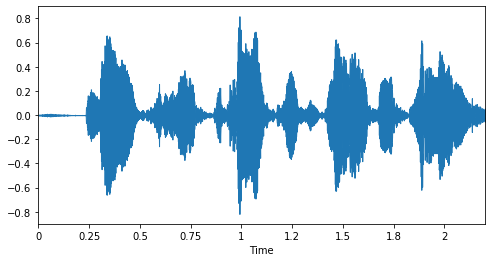

In [100]:
plot_play_audio(0,mask)

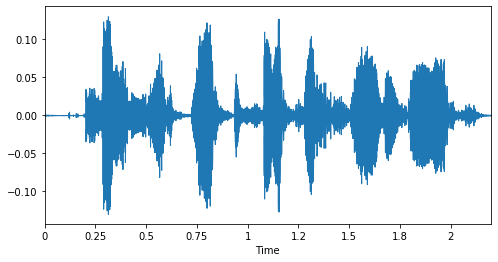

In [101]:
plot_play_audio(1,mask)

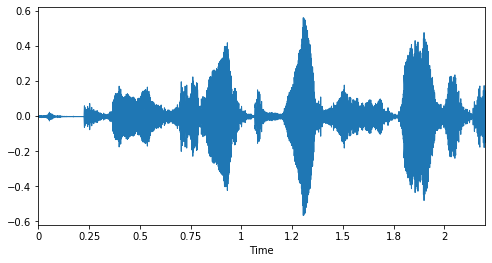

In [102]:
plot_play_audio(2,mask)

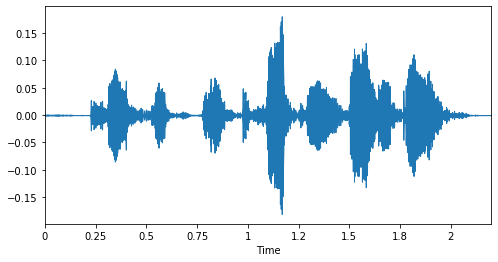

In [103]:
plot_play_audio(3,mask)

#### Actor 3/ Male / Angry / Statement 1

In [104]:
mask =(
       (df_merged['gender']=='male')&
       (df_merged['emotion_desc']=='angry')&
       (df_merged['actor']==3)&
       (df_merged['statement']==1)
      )

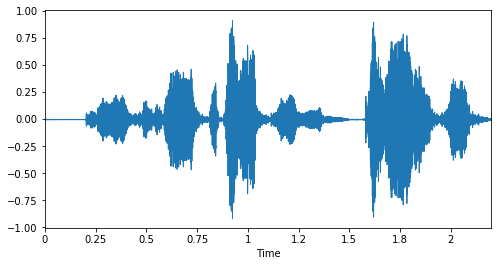

In [105]:
plot_play_audio(0,mask)

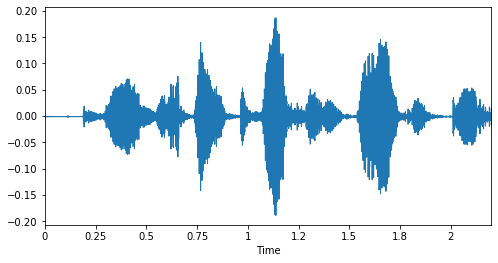

In [106]:
plot_play_audio(1,mask)

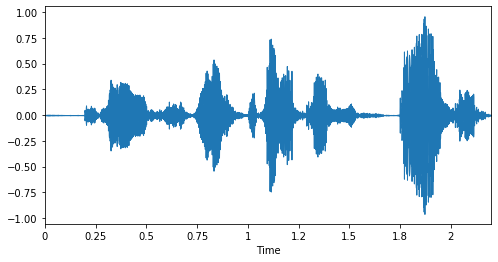

In [107]:
plot_play_audio(2,mask)

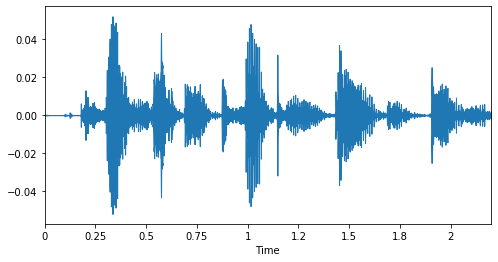

In [108]:
plot_play_audio(3,mask)

#### Actor 2/ Female / Angry / Statement 1

In [109]:
mask =(
       (df_merged['gender']=='female')&
       (df_merged['emotion_desc']=='angry')&
       (df_merged['actor']==2)&
       (df_merged['statement']==1)
      )

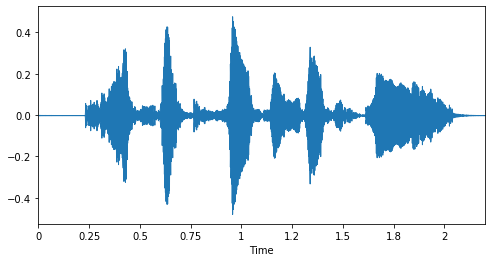

In [110]:
plot_play_audio(0,mask)

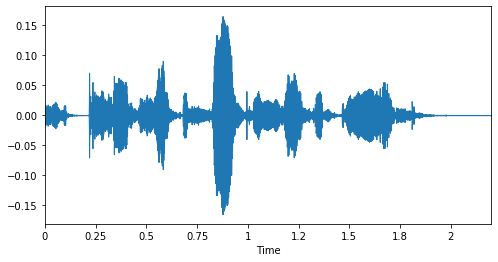

In [111]:
plot_play_audio(1,mask)

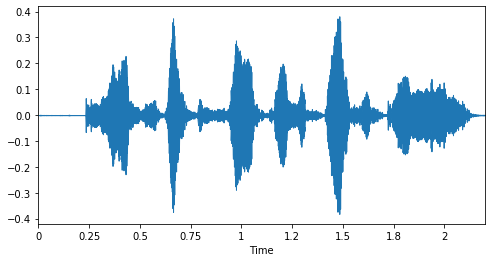

In [112]:
plot_play_audio(2,mask)

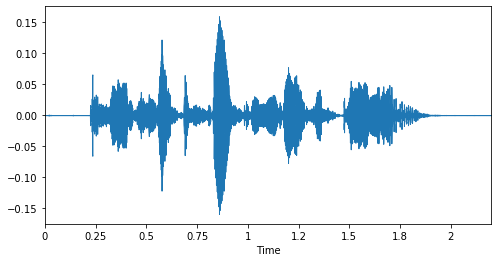

In [113]:
plot_play_audio(3,mask)

#### Actor 4/ Female / Angry / Statement 1

In [114]:
mask =(
       (df_merged['gender']=='female')&
       (df_merged['emotion_desc']=='angry')&
       (df_merged['actor']==4)&
       (df_merged['statement']==1)
      )

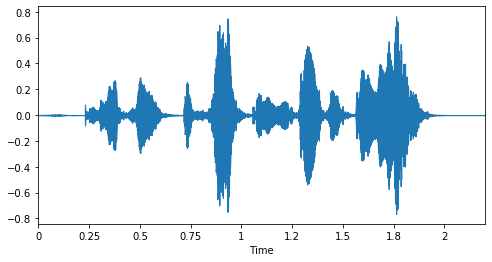

In [115]:
plot_play_audio(0,mask)

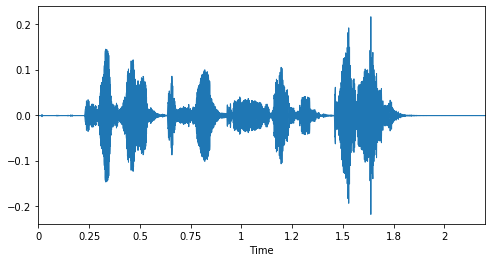

In [116]:
plot_play_audio(1,mask)

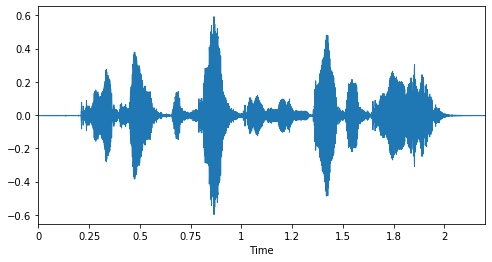

In [117]:
plot_play_audio(2,mask)

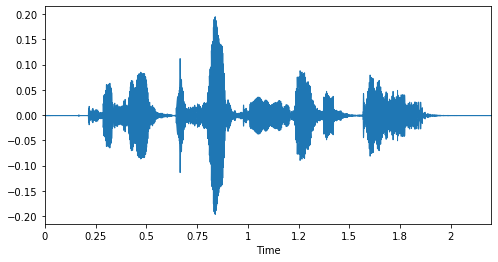

In [118]:
plot_play_audio(3,mask)

#### Actor 1 / Male / Happy / Statement 1

In [119]:
mask =(
       (df_merged['gender']=='male')&
       (df_merged['emotion_desc']=='happy')&
       (df_merged['actor']==1)&
       (df_merged['statement']==1)
      )

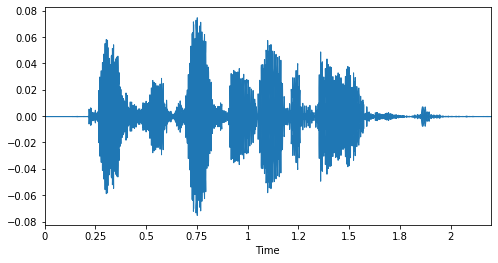

In [120]:
plot_play_audio(0,mask)

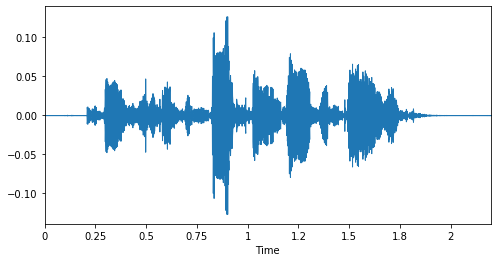

In [121]:
plot_play_audio(1,mask)

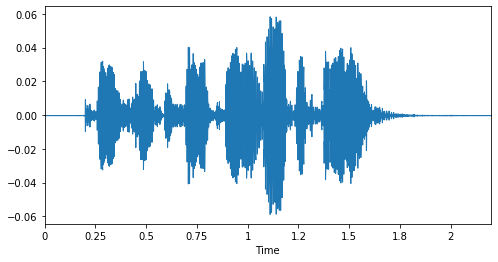

In [122]:
plot_play_audio(2,mask)

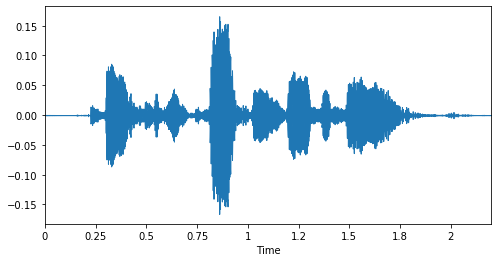

In [123]:
plot_play_audio(3,mask)

#### Actor 3 / Male / Happy / Statement 1

In [124]:
mask =(
       (df_merged['gender']=='male')&
       (df_merged['emotion_desc']=='happy')&
       (df_merged['actor']==3)&
       (df_merged['statement']==1)
      )

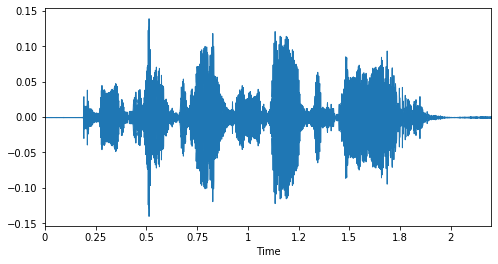

In [125]:
plot_play_audio(0,mask)

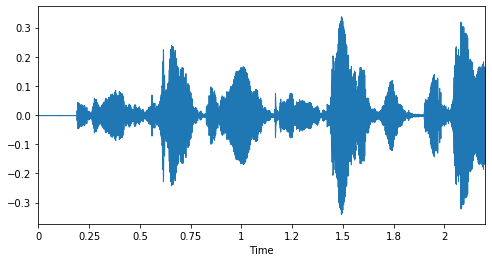

In [126]:
plot_play_audio(1,mask)

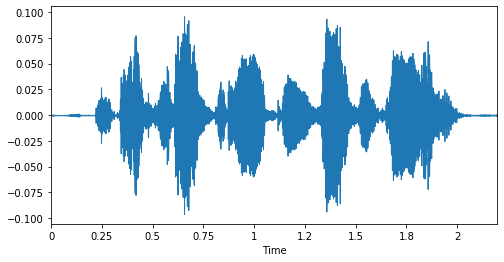

In [127]:
plot_play_audio(2,mask)

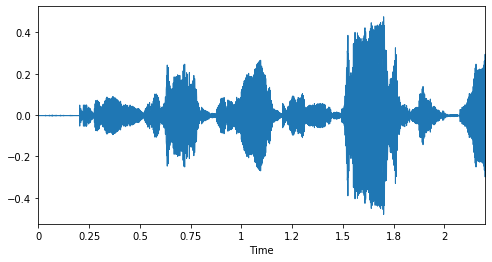

In [128]:
plot_play_audio(3,mask)

#### Actor 2/ Female / Happy / Statement 1

In [129]:
mask =(
       (df_merged['gender']=='female')&
       (df_merged['emotion_desc']=='happy')&
       (df_merged['actor']==2)&
       (df_merged['statement']==1)
      )

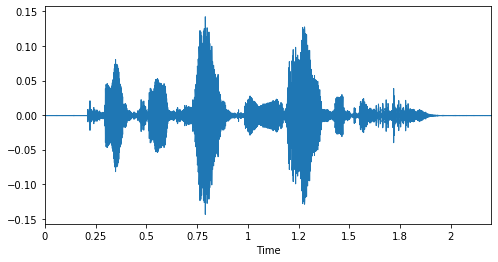

In [130]:
plot_play_audio(0,mask)

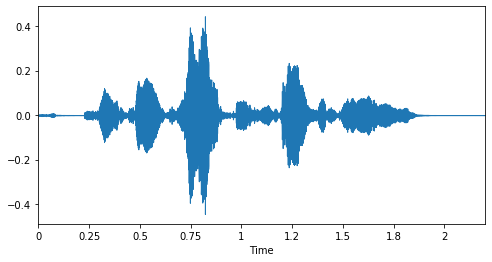

In [131]:
plot_play_audio(1,mask)

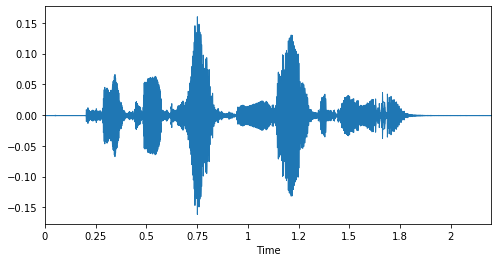

In [132]:
plot_play_audio(2,mask)

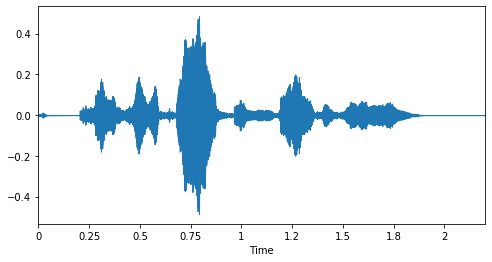

In [133]:
plot_play_audio(3,mask)

#### Actor 4/ Female / Happy / Statement 1

In [5]:
mask =(
       (df_merged['gender']=='female')&
       (df_merged['emotion_desc']=='happy')&
       (df_merged['actor']==4)&
       (df_merged['statement']==1)
      )

NameError: name 'df_merged' is not defined

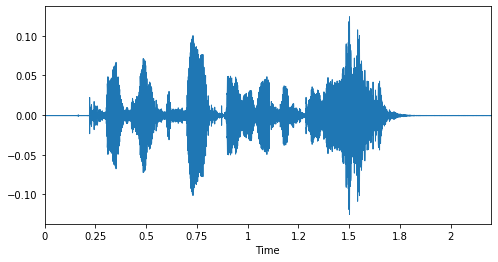

In [135]:
plot_play_audio(0,mask)

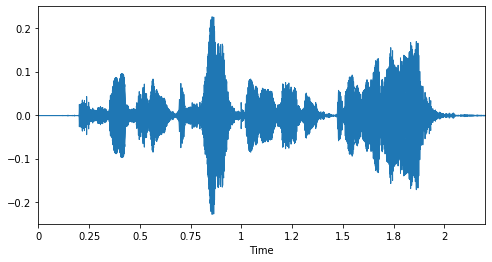

In [136]:
plot_play_audio(1,mask)

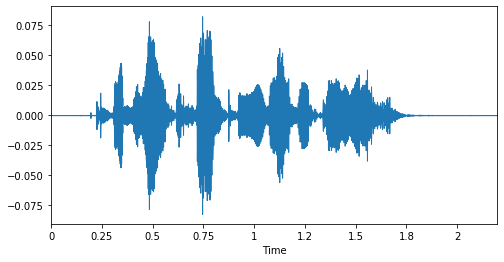

In [137]:
plot_play_audio(2,mask)

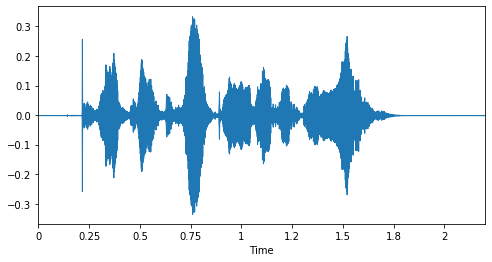

In [138]:
plot_play_audio(3,mask)

### Put Similar Categories Together & Visualize

#### Male & Angry & High Intensity & Repetition 1 & Statement 1

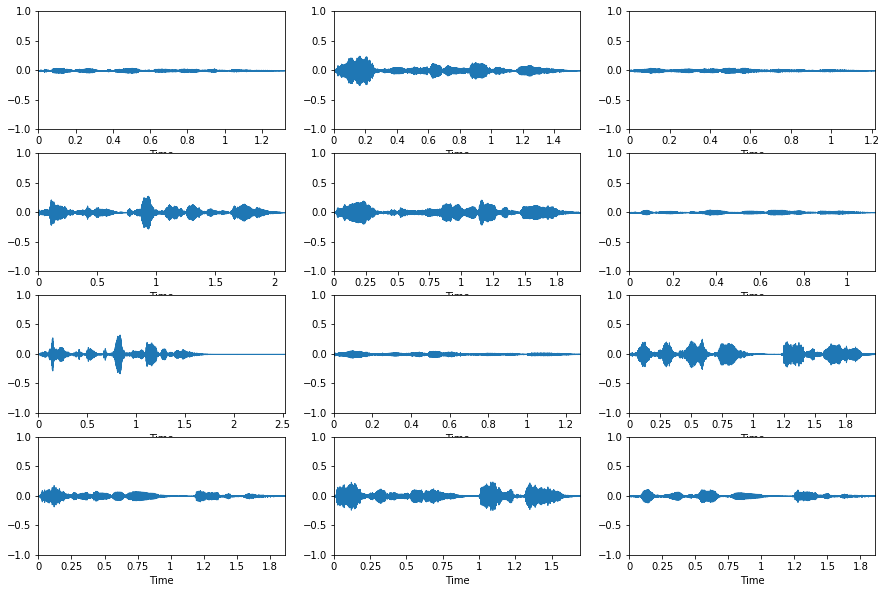

In [283]:
mask =(
       (df_raw['gender']=='male')&
       (df_raw['emotion_desc']=='happy')
      )

plt.figure(figsize=(15, 10))
for i, signal in enumerate(df_raw[mask]['signal_norm_trimmed'][0:12]):
    plt.subplot(4, 3, i+1)
    librosa.display.waveplot(signal)
    plt.ylim(-1, 1)

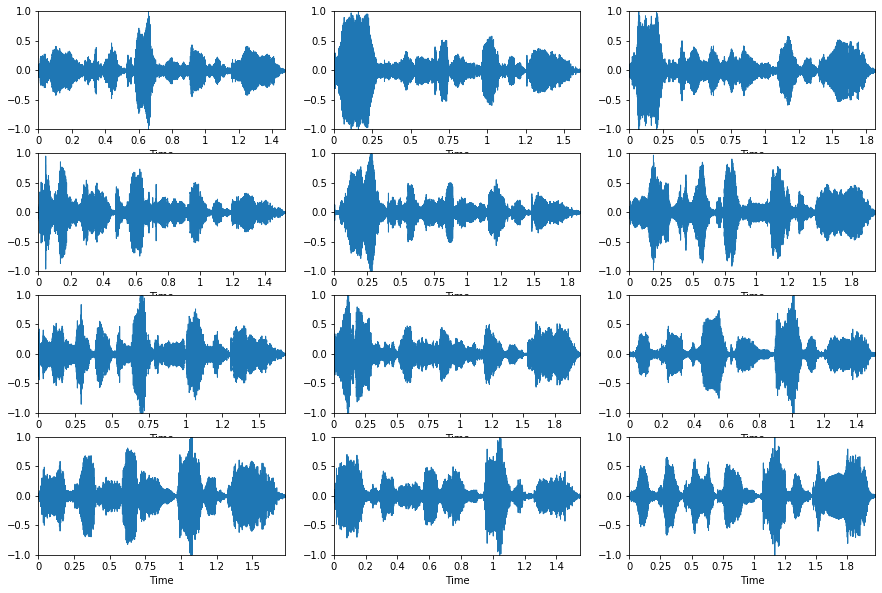

In [229]:
mask =(
       (df_raw['gender']=='male')&
       (df_raw['emotion_desc']=='angry')
      )

plt.figure(figsize=(15, 10))
for i, signal in enumerate(df_raw[mask]['signal_norm_trimmed'][0:12]):
    plt.subplot(4, 3, i+1)
    librosa.display.waveplot(signal)
    plt.ylim(-1, 1)

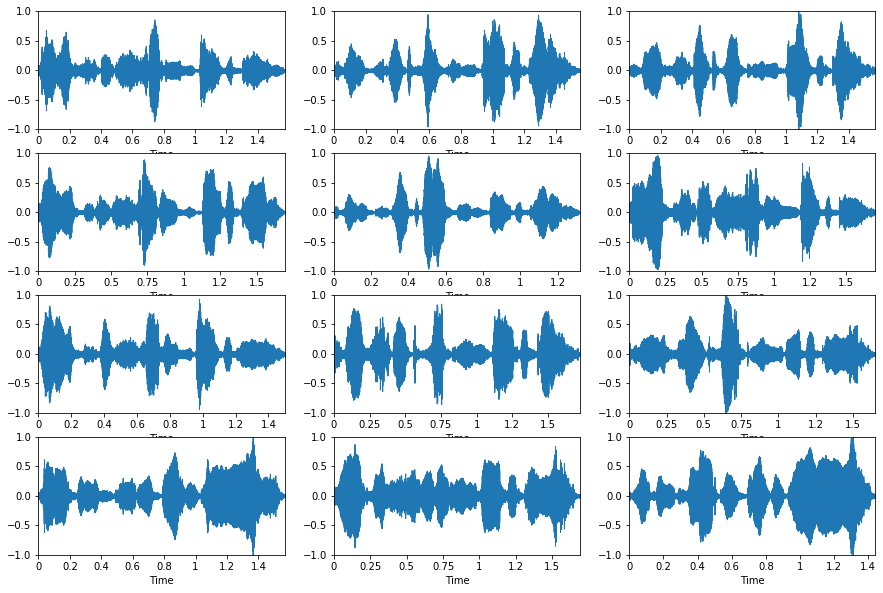

In [230]:
mask =(
       (df_raw['gender']=='female')&
       (df_raw['emotion_desc']=='angry')
      )

plt.figure(figsize=(15, 10))
for i, signal in enumerate(df_raw[mask]['signal_norm_trimmed'][0:12]):
    plt.subplot(4, 3, i+1)
    librosa.display.waveplot(signal)
    plt.ylim(-1, 1)

In [21]:
# Define cross-validation pipelines logistic regression model
lgbm_pipeline = Pipeline([
                        ('polynomial',PolynomialFeatures()),
                        ('standard',StandardScaler()),                        
                        ('model',LGBMClassifier())
                        ])

# # print parameters for lasso & ridge cross-validation pipelines
print('Logistic Regression Model Params :\n\n',lr_pipeline.get_params().keys(),'\n')

Logistic Regression Model Params :

 dict_keys(['memory', 'steps', 'verbose', 'polynomial', 'standard', 'model', 'polynomial__degree', 'polynomial__include_bias', 'polynomial__interaction_only', 'polynomial__order', 'standard__copy', 'standard__with_mean', 'standard__with_std', 'model__boosting_type', 'model__class_weight', 'model__colsample_bytree', 'model__importance_type', 'model__learning_rate', 'model__max_depth', 'model__min_child_samples', 'model__min_child_weight', 'model__min_split_gain', 'model__n_estimators', 'model__n_jobs', 'model__num_leaves', 'model__objective', 'model__random_state', 'model__reg_alpha', 'model__reg_lambda', 'model__silent', 'model__subsample', 'model__subsample_for_bin', 'model__subsample_freq']) 



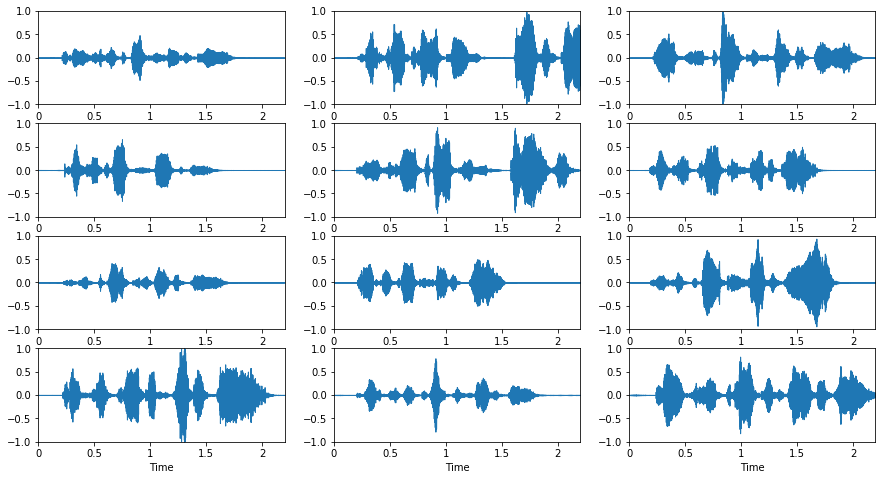

In [169]:
mask =(
       (df_merged['gender']=='male')&
       (df_merged['emotion_desc']=='angry')&
       (df_merged['emotion_intensity']==2)&
       (df_merged['repetition']==1)&
       (df_merged['statement']==1)
      )

plt.figure(figsize=(15, 10))
for i, file_name in enumerate(df_merged[mask]['filename']):
    plt.subplot(5, 3, i+1)
    sound_wave,sampling_rate = librosa.load(file_name,sr=None,duration=2.2,offset=0.8,res_type='kaiser_fast')
    librosa.display.waveplot(sound_wave,sr=sampling_rate)
    plt.ylim(-1, 1)

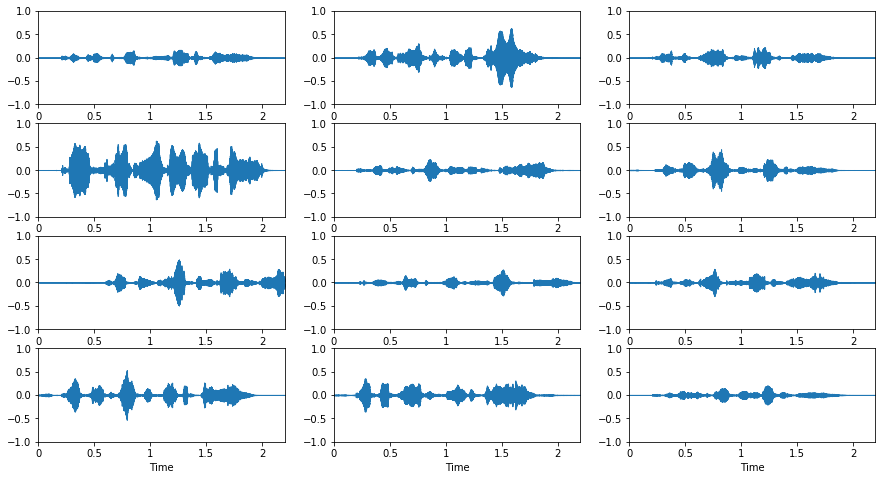

In [175]:
mask =(
       (df_merged['gender']=='female')&
       (df_merged['emotion_desc']=='happy')&
       (df_merged['emotion_intensity']==2)&
       (df_merged['repetition']==1)&
       (df_merged['statement']==1)
      )

plt.figure(figsize=(15, 10))
for i, file_name in enumerate(df_merged[mask]['filename']):
    plt.subplot(5, 3, i+1)
    sound_wave,sampling_rate = librosa.load(file_name,sr=None,duration=2.2,offset=0.8,res_type='kaiser_fast')
    librosa.display.waveplot(sound_wave,sr=sampling_rate)
    plt.ylim(-1, 1)

# 7. Modeling

### Confusion Matrix  & Scoring Functions

In [7]:
def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    #classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    #print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

def various_scores_string_binary(model,X,y,data_type):
    pred = model.predict(X)
    binarizer = MultiLabelBinarizer()
    binarizer.fit(y)

    print(data_type," Data")
    print("Accuracy : {:.2f} %".format(metrics.accuracy_score(binarizer.transform(y),binarizer.transform(pred))*100))
    print("Precision : {:.2f}".format(metrics.precision_score(binarizer.transform(y),binarizer.transform(pred),average='macro')))
    print("Recall : {:.2f}".format(metrics.recall_score(binarizer.transform(y),binarizer.transform(pred),average='macro')))
    print("F1 : {:.2f}".format(metrics.f1_score(binarizer.transform(y),binarizer.transform(pred),average='macro')))
    
def various_scores(model,X,y,data_type):
    pred = model.predict(X)
    print(data_type," Data")
    print('######################################################')
    print("Accuracy : {:.2f} %".format(metrics.accuracy_score(y, pred)*100))
    print('______________________________________________________')
    print(metrics.classification_report(y,pred,digits=2))
    print('______________________________________________________')   
    

## Gender Classification

#### Train, Validation, Test Split

In [83]:
# df_combined_processed_30_10000.pkl   df_combined_processed_30_300_norm.pkl    df_combined_processed_rms_pitch.pkl
with open('df_combined_processed_rms_pitch.pkl', 'rb') as picklefile: 
    df_combined_processed = pickle.load(picklefile)

In [8]:
df_combined_processed.head()

,filename,dataset,gender,emotion_desc,stripped,mfcc,rmsed,pitch_list,pitch_mag_list,pitch_stat_from_rms
0,data/Actor_16/03-01-05-01-02-01-16.wav,ravdess,female,angry,"[6.517186e-05, 6.8997574e-06, -2.0190453e-06, ...","[-366.8914, 71.77935, -20.150389, 11.895988, -...","[0.017874429002404213, 0.022185618057847023, 0...","[39.19791030883789, 233.84451293945312, 134.33...","[0.0049803671427071095, 0.005499514751136303, ...","[256.2477, 22.363346, 212.0984, 285.41583]"
1,data/Actor_16/03-01-06-01-02-02-16.wav,ravdess,female,fearful,"[1.1823112e-06, 1.1033082e-05, 4.2832426e-06, ...","[-399.89087, 80.28237, -14.706097, 11.243801, ...","[0.013143708929419518, 0.018246106803417206, 0...","[46.853675842285156, 235.36053466796875, 92.35...","[0.005501719191670418, 0.007022419478744268, 4...","[251.07616, 10.260817, 237.87947, 269.0038]"
2,data/Actor_16/03-01-06-02-01-02-16.wav,ravdess,female,fearful,"[0.00012321812, 0.0012073589, 0.00078663975, 6...","[-323.05536, 34.20902, -45.367153, 7.12596, -2...","[0.07463786005973816, 0.053669851273298264, 2....","[77.74604797363281, 207.351318359375, 64.60456...","[0.00389516050927341, 0.001404440263286233, 0....","[229.54955, 36.881042, 160.98633, 294.70685]"
3,data/Actor_16/03-01-05-02-01-01-16.wav,ravdess,female,angry,"[0.00028398796, 3.8944265e-05, -0.00027669346,...","[-288.9275, 72.76716, -26.86252, 15.288108, -2...","[0.04624861851334572, 0.044992782175540924, 0....","[48.386356353759766, 249.08541870117188, 121.7...","[0.010916835628449917, 0.009816412813961506, 0...","[287.54938, 18.93939, 254.89552, 310.6248]"
4,data/Actor_16/03-01-07-01-01-01-16.wav,ravdess,female,disgust,"[-1.309358e-05, -6.2199346e-05, -1.4566674e-05...","[-446.76715, 95.847694, -9.51983, 22.404377, -...","[0.006015528924763203, 0.008390865288674831, 0...","[38.069583892822266, 223.78219604492188, 67.84...","[0.002692753216251731, 0.0031417852733284235, ...","[223.51173, 11.694811, 206.4314, 239.6462]"


In [73]:
X_pitch_stat = pd.DataFrame(list(df_combined_processed['pitch_stat_from_rms']))
X_pitch_extract = pd.DataFrame(list(df_combined_processed['pitch_list']))
X_pitch_mag_extract = pd.DataFrame(list(df_combined_processed['pitch_mag_list']))
X_rms_extract = pd.DataFrame(list(df_combined_processed['rmsed']))
X_mfcc = pd.DataFrame(list(df_combined_processed['mfcc']))



df_multiple_features = pd.concat([X_pitch_stat,X_pitch_extract], axis=1)

# For X, choose one of the three dataframe at the top
X = df_multiple_features
y_gender = pd.DataFrame({'gender':np.array(df_combined_processed['gender'])})
df_X_y = pd.concat([X,y_gender], axis=1)
df_X_y.dropna(inplace=True)
y_gender = df_X_y['gender']
X = df_X_y.drop(['gender'],axis=1)

X_train, X_test, y_train, y_test = train_test_split(X, y_gender, test_size=0.2,random_state=209)


In [ ]:
sns.pairplot(pd.concat([X_pitch_mag_extract,y_gender],axis=1),hue='gender')

In [47]:
# # df_combined_processed_2000hz, df_combined_processed_4000hz, df_combined_processed_8000hz, df_combined_processed_10000hz, df_combined_processed_15000hz.pkl
# with open('df_combined_processed_rfft.pkl', 'rb') as picklefile: 
#     df_combined_processed = pickle.load(picklefile)
# df_ravdess = df_combined_processed[df_combined_processed['dataset']=='ravdess'].copy()
# df_tess = df_combined_processed[df_combined_processed['dataset']=='tess'].copy()


# X_mfcc = pd.DataFrame(list(df_combined_processed['mfcc']))
# X_ffted_compressed = pd.DataFrame(list(df_combined_processed['rffted_compressed']))
# df_mfcc_ffted = pd.concat([X_mfcc, X_ffted_compressed], axis=1)

# # For X, choose one of the three dataframe at the top
# X = df_mfcc_ffted
# y_gender = np.array(df_combined_processed['gender'])

# X_train, X_test, y_train, y_test = train_test_split(X, y_gender, test_size=0.2,random_state=209)



### Logistic Regression - Baseline

In [85]:
# Standardization
std = StandardScaler()
std.fit(X_train)
X_tr = std.transform(X_train)
X_te = std.transform(X_test)

lr_gender = LogisticRegression(random_state=209, solver='lbfgs',
                          multi_class='ovr')
lr_gender.fit(X_tr, y_train)
various_scores_string_binary(lr_gender,X_tr,y_train,'Train')
print('______________________')
various_scores_string_binary(lr_gender,X_te,y_test,'Test')

Train  Data
Accuracy : 77.30 %
Precision : 0.95
Recall : 0.97
F1 : 0.96
______________________
Test  Data
Accuracy : 76.89 %
Precision : 0.95
Recall : 0.96
F1 : 0.96


/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


### RandomForrest - Baseline

In [97]:
rf_gender = RandomForestClassifier(n_estimators=100, min_samples_split=20)
rf_gender.fit(X_train,y_train)

various_scores_string_binary(rf_gender,X_train,y_train,'Train')
print('______________________')
various_scores_string_binary(rf_gender,X_test,y_test,'Test')

Train  Data
Accuracy : 93.04 %
Precision : 0.99
Recall : 0.99
F1 : 0.99
______________________
Test  Data
Accuracy : 82.31 %
Precision : 0.97
Recall : 0.96
F1 : 0.96


### LightGBM - Baseline

In [134]:
lgbm_gender = LGBMClassifier(max_depth=2,num_leaves=40,objective='binary',random_state=209)
lgbm_gender.fit(X_train,y_train)

various_scores_string_binary(lgbm_gender,X_train,y_train,'Train')
print('______________________')
various_scores_string_binary(lgbm_gender,X_test,y_test,'Test')

Train  Data
Accuracy : 98.97 %
Precision : 1.00
Recall : 1.00
F1 : 1.00
______________________
Test  Data
Accuracy : 98.35 %
Precision : 0.99
Recall : 1.00
F1 : 1.00


### LightGBM - RandomizedSearchCV

In [74]:
# Define cross-validation pipelines logistic regression model
lgbm_pipeline = Pipeline([
                        ('polynomial',PolynomialFeatures()),
                        #('standard',StandardScaler()),                        
                        ('model',LGBMClassifier())
                        ])

# # print parameters for lasso & ridge cross-validation pipelines
# print('Logistic Regression Model Params :\n\n',lgbm_pipeline.get_params().keys(),'\n')

In [75]:
#Define hyperparameters for GridSearchCV & RandomizedSearchCV
scoring_list = ['accuracy', 'balanced_accuracy','f1_micro','f1_macro','f1_weighted']
hyperparameters = {'polynomial__degree':[1],
                   'model__boosting_type':['gbdt'],#gbdt, gbrt, rf, random_forest, dart, goss
                   #'model__class_weight':[],
                   #'model__colsample_bytree':[0.33,0.66,1],
                   #'model__importance_type':[],
                   #'model__learning_rate':[0.01],
                   'model__max_depth':[-1,3,4,5,6],
                   'model__min_child_samples':[10,20,40], # Default 20
                   #'model__min_child_weight':[0.001], # Default 0.001
                   #'model__min_split_gain':[0], # Default 0
                   #'model__n_estimators':[100], # Default 100
                   #'model__n_jobs':[0], # Default 0. Num_threads
                   'model__num_leaves':[6,15,31,62], # Default 31
                   'model__objective':['binary'],
                   'model__random_state':[209],
                   'model__reg_alpha':[0,0.5,1], # Default 0
                   'model__reg_lambda':[0,0.5,1] # Default 0
                   #'model__silent':[], # No info
                   #'model__subsample':[1], # Default 1
                   #'model__subsample_for_bin':[], # Default 200000
                   #'model__subsample_freq':[0], # Default 0
                   
                   }
lgbm_grid_gender = RandomizedSearchCV(estimator=lgbm_pipeline,
                             param_distributions=hyperparameters,
                             cv=5,
                             random_state=209,
                             scoring=scoring_list[3],
                             #n_iter=10,
                             verbose=1)
lgbm_grid_gender.fit(X_train,y_train)
print(lgbm_grid_gender.best_params_)
print('______________________')
various_scores_string_binary(lgbm_grid_gender,X_train,y_train,'Train')
print('______________________')
various_scores_string_binary(lgbm_grid_gender,X_test,y_test,'Test')

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:    4.0s finished


{'polynomial__degree': 1, 'model__reg_lambda': 0, 'model__reg_alpha': 0, 'model__random_state': 209, 'model__objective': 'binary', 'model__num_leaves': 62, 'model__min_child_samples': 10, 'model__max_depth': 6, 'model__boosting_type': 'gbdt'}
______________________
Train  Data
Accuracy : 97.19 %
Precision : 0.99
Recall : 0.99
F1 : 0.99
______________________
Test  Data
Accuracy : 85.11 %
Precision : 0.97
Recall : 0.97
F1 : 0.97


#### Real Test

In [76]:
formats_to_convert = ['.m4a']
# test_data youtube_test
folder = "test_data/"

for (dirpath, dirnames, filenames) in os.walk(folder):
    for filename in filenames:
        if filename.endswith(tuple(formats_to_convert)):

            filepath = dirpath + '/' + filename
            (path, file_extension) = os.path.splitext(filepath)
            file_extension_final = file_extension.replace('.', '')
            try:
                track = AudioSegment.from_file(filepath,
                        file_extension_final)
                wav_filename = filename.replace(file_extension_final, 'wav')
                wav_path = dirpath + '/' + wav_filename
                print('CONVERTING: ' + str(filepath))
                file_handle = track.export(wav_path, format='wav')
                os.remove(filepath)
            except:
                print("ERROR CONVERTING " + str(filepath))
def process_test_data():
    # Load files to test
    test_data_folder_list = os.listdir(folder)
    if '.DS_Store' in test_data_folder_list:
        test_data_folder_list.remove('.DS_Store')
    test_data_folder_list = [folder+x for x in test_data_folder_list]

    # Create dataframe for test data
    df_test = pd.DataFrame({'filename':test_data_folder_list})

    # Process df_test and create ffted,mfcc,and etc...
    df_test_processed = df_preprocess(df_test)

    X_test_pitch_stat = pd.DataFrame(list(df_test_processed['pitch_stat_from_rms']))
    X_test_pitch_extract = pd.DataFrame(list(df_test_processed['pitch_list']))
    X_test_pitch_mag_extract = pd.DataFrame(list(df_test_processed['pitch_mag_list']))
    X_test_rms_extract = pd.DataFrame(list(df_test_processed['rmsed']))
    X_test_mfcc = pd.DataFrame(list(df_test_processed['mfcc']))

    df_test_multiple_features = pd.concat([X_test_pitch_stat,X_test_pitch_extract], axis=1)

    # For X_real_test, choose one of the top
    test_gender = df_test_multiple_features.dropna()
    test_class = X_test_mfcc
    return test_gender,test_class,df_test_processed

def predict_gender_and_emotion(model_gender,data_gender,df_test_processed):
    pred_gender = model_gender.predict(data_gender)
    pred_gender_proba = model_gender.predict_proba(data_gender)
    for i in range(len(df_test_processed)):
        print('{}[{}] : {}'.format(pred_gender[i],pred_gender_proba[i],df_test_processed['filename'][i].split('/')[1].split('.')[0]))
        IPython.display.display(Audio(df_test_processed['stripped'][i],rate=22050))
        print('____________________')
test_gender,test_class,df_test_processed = process_test_data()
predict_gender_and_emotion(lgbm_grid_gender,test_gender,df_test_processed)

  0%|          | 0/19 [00:00<?, ?it/s]/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
100%|██████████| 19/19 [00:08<00:00,  2.68it/s]

female[[0.98092251 0.01907749]] : eva_sad


____________________
female[[0.85414477 0.14585523]] : benson_outlier


____________________
male[[0.03191139 0.96808861]] : low_matt


____________________
male[[0.40597713 0.59402287]] : eva


____________________
male[[0.11614776 0.88385224]] : danielo_wrong


____________________
female[[0.99872558 0.00127442]] : evahappy


____________________
female[[0.76991849 0.23008151]] : youtube


____________________
female[[0.9017544 0.0982456]] : high_matt


____________________
female[[0.98465847 0.01534153]] : eva_sad2


____________________
female[[0.79998472 0.20001528]] : eva2


____________________
female[[0.97731677 0.02268323]] : eva3


____________________
female[[0.80788296 0.19211704]] : danielo_2


____________________
female[[0.91724087 0.08275913]] : eva1


____________________
male[[0.07895391 0.92104609]] : matt1


____________________
female[[0.91483732 0.08516268]] : valentina


____________________
male[[0.27565078 0.72434922]] : female


____________________
male[[0.41122988 0.58877012]] : mick


____________________
female[[0.68084917 0.31915083]] : evaangry


____________________
female[[0.71437341 0.28562659]] : jhonny


____________________


## Emotion Classification - Multiclass

I think mfcc takes gender out of equation. Try it for emption. It might take emotion out of equation as well ... For now frequency extracted gives a good score for gender classification

#### Train, Validation, Test Split

In [79]:
with open('df_combined_processed_rms_pitch.pkl', 'rb') as picklefile: 
    df_combined_processed = pickle.load(picklefile)

# Based on EDA, we'll combine 'neutral' and 'calm' by converting 'calm' to 'neutral'  
df_combined_processed['emotion_desc']=[x.replace('calm','neutral') for x in list(df_combined_processed['emotion_desc'])]
    
X_pitch_stat = pd.DataFrame(list(df_combined_processed['pitch_stat_from_rms']))
X_pitch_extract = pd.DataFrame(list(df_combined_processed['pitch_list']))
X_pitch_mag_extract = pd.DataFrame(list(df_combined_processed['pitch_mag_list']))
X_rms_extract = pd.DataFrame(list(df_combined_processed['rmsed']))
X_mfcc = pd.DataFrame(list(df_combined_processed['mfcc']))

df_multiple_features = pd.concat([X_pitch_stat,X_pitch_extract,X_pitch_mag_extract,X_rms_extract,X_mfcc], axis=1)

# For X, choose one of the three dataframe at the top
X = df_multiple_features
y_class = pd.DataFrame({'emotion_desc':np.array(df_combined_processed['emotion_desc'])})


df_X_y = pd.concat([X,y_class], axis=1)
df_X_y.dropna(inplace=True)
y_class = df_X_y['emotion_desc']
X = df_X_y.drop(['emotion_desc'],axis=1)

X_train, X_test, y_train, y_test = train_test_split(X, y_class, test_size=0.2,random_state=209)

### Logistic Regression - Baseline

/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


Train  Data
######################################################
Accuracy : 74.44 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.80      0.82      0.81       463
     disgust       0.71      0.76      0.73       472
     fearful       0.79      0.77      0.78       476
       happy       0.65      0.59      0.62       480
     neutral       0.76      0.86      0.81       541
         sad       0.79      0.74      0.76       482
   surprised       0.69      0.68      0.68       478

    accuracy                           0.74      3392
   macro avg       0.74      0.74      0.74      3392
weighted avg       0.74      0.74      0.74      3392

______________________________________________________
Test  Data
######################################################
Accuracy : 71.46 %
______________________________________________________
              precision    recall  f1-score   support

       angry

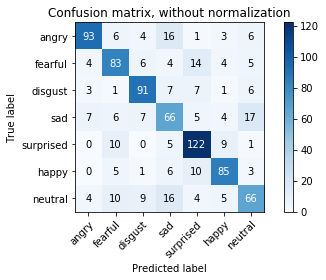

In [124]:
# Standardization
std = StandardScaler()
std.fit(X_train)
X_tr = std.transform(X_train)
X_te = std.transform(X_test)

lr_class = LogisticRegression(random_state=209, solver='lbfgs',
                          multi_class='multinomial',C=1)
lr_class.fit(X_tr, y_train)

various_scores(lr_class,X_tr,y_train,'Train')
various_scores(lr_class,X_te,y_test,'Test')
plot_confusion_matrix((y_test),lr_class.predict(std.transform(X_test)),classes=list(df_combined_processed['emotion_desc'].unique()));

### RandomForrest - Baseline

Train  Data
######################################################
Accuracy : 76.15 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.73      0.82      0.77       463
     disgust       0.58      0.79      0.67       472
     fearful       0.90      0.76      0.83       476
       happy       0.96      0.63      0.76       480
     neutral       0.66      0.93      0.77       541
         sad       0.99      0.69      0.81       482
   surprised       0.80      0.69      0.75       478

    accuracy                           0.76      3392
   macro avg       0.80      0.76      0.76      3392
weighted avg       0.80      0.76      0.77      3392

______________________________________________________
Train  Data
######################################################
Accuracy : 74.88 %
______________________________________________________
              precision    recall  f1-score   support

       angr

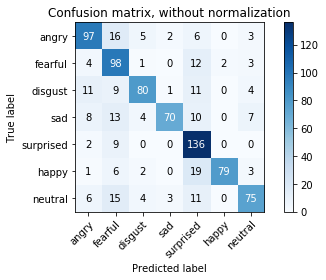

In [125]:
rf_class = RandomForestClassifier(n_estimators=100, max_depth=5, min_samples_split=3)
rf_class.fit(X_train,y_train)

various_scores(rf_class,X_train,y_train,'Train')
various_scores(rf_class,X_test,y_test,'Train')
plot_confusion_matrix((y_test),rf_class.predict(X_test),classes=list(df_combined_processed['emotion_desc'].unique()));

### LightGBM - Baseline

In [126]:
lgbm_class = LGBMClassifier(max_depth=3,num_leaves=10,objective='multiclass',random_state=209)
lgbm_class.fit(X_train,y_train)

various_scores(lgbm_class,X_train,y_train,'Train')
various_scores(lgbm_class,X_test,y_test,'Test')

Train  Data
######################################################
Accuracy : 92.07 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.96      0.93      0.94       463
     disgust       0.86      0.90      0.88       472
     fearful       0.97      0.91      0.94       476
       happy       0.94      0.92      0.93       480
     neutral       0.86      0.99      0.92       541
         sad       0.96      0.88      0.92       482
   surprised       0.93      0.90      0.92       478

    accuracy                           0.92      3392
   macro avg       0.92      0.92      0.92      3392
weighted avg       0.92      0.92      0.92      3392

______________________________________________________
Test  Data
######################################################
Accuracy : 82.08 %
______________________________________________________
              precision    recall  f1-score   support

       angry

### LightGBM - RandomizedSearchCV

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:  1.1min finished


Train  Data
######################################################
Accuracy : 100.00 %
______________________________________________________
              precision    recall  f1-score   support

       angry       1.00      1.00      1.00       470
     disgust       1.00      1.00      1.00       469
     fearful       1.00      1.00      1.00       474
       happy       1.00      1.00      1.00       478
     neutral       1.00      1.00      1.00       538
         sad       1.00      1.00      1.00       471
   surprised       1.00      1.00      1.00       480

    accuracy                           1.00      3380
   macro avg       1.00      1.00      1.00      3380
weighted avg       1.00      1.00      1.00      3380

______________________________________________________
Test  Data
######################################################
Accuracy : 88.18 %
______________________________________________________
              precision    recall  f1-score   support

       angr

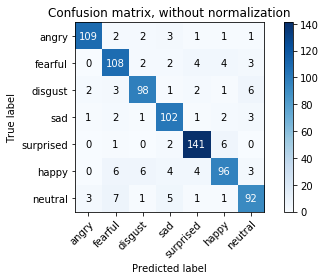

In [80]:
lgbm_grid_class = RandomizedSearchCV(estimator=lgbm_pipeline,
                             param_distributions=hyperparameters,
                             cv=3,
                             random_state=209,
                             scoring=scoring_list[3],
                             #n_iter=10,
                             verbose=1)
lgbm_grid_class.fit(X_train,y_train)

lgbm_grid_class.best_params_
various_scores(lgbm_grid_class,X_train,y_train,'Train')
various_scores(lgbm_grid_class,X_test,y_test,'Test')
plot_confusion_matrix((y_test),lgbm_grid_class.predict(X_test),classes=list(df_combined_processed['emotion_desc'].unique()));

## Emotion Classification - Multiclass - Gender Specific

#### Train, Validation, Test Split

In [15]:
# Male  df_combined_processed
df_combined_processed_male = df_combined_processed[df_combined_processed['gender']=='male'].copy()

X_mfcc_male = pd.DataFrame(list(df_combined_processed_male['mfcc']))
X_ffted_compressed_male = pd.DataFrame(list(df_combined_processed_male['rffted_compressed']))
df_mfcc_ffted_male = pd.concat([X_mfcc_male, X_ffted_compressed_male], axis=1)

X_male = df_mfcc_ffted_male
y_gender_male = np.array(df_combined_processed_male['emotion_desc'])
X_train_male, X_test_male, y_train_male, y_test_male = train_test_split(X_male, y_gender_male, test_size=0.1,random_state=209)

# Female
df_combined_processed_female = df_combined_processed[df_combined_processed['gender']=='female'].copy()

X_mfcc_female = pd.DataFrame(list(df_combined_processed_female['mfcc']))
X_ffted_compressed_female = pd.DataFrame(list(df_combined_processed_female['rffted_compressed']))
df_mfcc_ffted_female = pd.concat([X_mfcc_female, X_ffted_compressed_female], axis=1)

X_female = df_mfcc_ffted_female
y_gender_female = np.array(df_combined_processed_female['emotion_desc'])
X_train_female, X_test_female, y_train_female, y_test_female = train_test_split(X_female, y_gender_female, test_size=0.2,random_state=209)

### Logistic Regression - Baseline

#### Male

/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


Train  Data
######################################################
Accuracy : 81.39 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.88      0.89      0.88       262
     disgust       0.80      0.80      0.80       273
     fearful       0.86      0.81      0.83       266
       happy       0.74      0.76      0.75       267
     neutral       0.82      0.90      0.86       308
         sad       0.83      0.80      0.81       267
   surprised       0.76      0.74      0.75       265

    accuracy                           0.81      1908
   macro avg       0.81      0.81      0.81      1908
weighted avg       0.81      0.81      0.81      1908

______________________________________________________
Test  Data
######################################################
Accuracy : 76.42 %
______________________________________________________
              precision    recall  f1-score   support

       angry

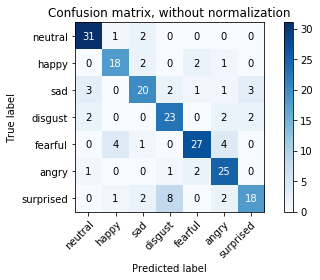

In [105]:
std_male = StandardScaler()
std_male.fit(X_train_male)
X_tr_male = std_male.transform(X_train_male)
X_te_male = std_male.transform(X_test_male)

lr_class_male = LogisticRegression(random_state=209, solver='lbfgs',
                          multi_class='multinomial',C=2)
lr_class_male.fit(X_tr_male, y_train_male)

various_scores(lr_class_male,X_tr_male,y_train_male,'Train')
various_scores(lr_class_male,X_te_male,y_test_male,'Test')
plot_confusion_matrix((y_test_male),lr_class_male.predict(std_male.transform(X_test_male)),classes=list(df_combined_processed_male['emotion_desc'].unique()));

#### Female

/Users/matthewlee/anaconda3/envs/metis/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:947: ConvergenceWarning: lbfgs failed to converge. Increase the number of iterations.
  "of iterations.", ConvergenceWarning)


Train  Data
######################################################
Accuracy : 84.14 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.86      0.86      0.86       235
     disgust       0.77      0.81      0.79       230
     fearful       0.86      0.83      0.84       228
       happy       0.88      0.85      0.87       240
     neutral       0.84      0.92      0.88       281
         sad       0.81      0.76      0.79       242
   surprised       0.87      0.83      0.85       240

    accuracy                           0.84      1696
   macro avg       0.84      0.84      0.84      1696
weighted avg       0.84      0.84      0.84      1696

______________________________________________________
Test  Data
######################################################
Accuracy : 82.31 %
______________________________________________________
              precision    recall  f1-score   support

       angry

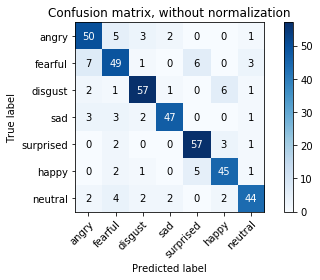

In [106]:
std_female = StandardScaler()
std_female.fit(X_train_female)
X_tr_female = std_female.transform(X_train_female)
X_te_female = std_female.transform(X_test_female)

lr_class_female = LogisticRegression(random_state=209, solver='lbfgs',
                          multi_class='multinomial',C=2)
lr_class_female.fit(X_tr_female, y_train_female)

various_scores(lr_class_female,X_tr_female,y_train_female,'Train')
various_scores(lr_class_female,X_te_female,y_test_female,'Test')
plot_confusion_matrix((y_test_female),lr_class_female.predict(std_female.transform(X_test_female)),classes=list(df_combined_processed_female['emotion_desc'].unique()));

### RandomForrest - Baseline

#### Male

Train  Data
######################################################
Accuracy : 81.18 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.83      0.84      0.83       262
     disgust       0.73      0.88      0.80       273
     fearful       0.94      0.76      0.84       266
       happy       0.91      0.72      0.80       267
     neutral       0.75      0.96      0.84       308
         sad       0.94      0.75      0.84       267
   surprised       0.71      0.74      0.72       265

    accuracy                           0.81      1908
   macro avg       0.83      0.81      0.81      1908
weighted avg       0.83      0.81      0.81      1908

______________________________________________________
Test  Data
######################################################
Accuracy : 77.83 %
______________________________________________________
              precision    recall  f1-score   support

       angry

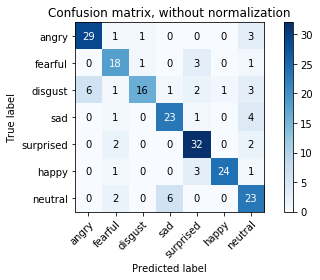

In [107]:
rf_class_male = RandomForestClassifier(n_estimators=100, max_depth=5, min_samples_split=3)
rf_class_male.fit(X_train_male,y_train_male)

various_scores(rf_class_male,X_train_male,y_train_male,'Train')
various_scores(rf_class_male,X_test_male,y_test_male,'Test')
plot_confusion_matrix((y_test_male),rf_class_male.predict(X_test_male),classes=list(df_combined_processed['emotion_desc'].unique()));

#### Female

Train  Data
######################################################
Accuracy : 84.08 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.91      0.84      0.87       235
     disgust       0.66      0.90      0.76       230
     fearful       0.93      0.85      0.89       228
       happy       0.99      0.73      0.84       240
     neutral       0.74      0.96      0.84       281
         sad       0.94      0.75      0.83       242
   surprised       0.89      0.84      0.86       240

    accuracy                           0.84      1696
   macro avg       0.87      0.84      0.84      1696
weighted avg       0.86      0.84      0.84      1696

______________________________________________________
Test  Data
######################################################
Accuracy : 79.95 %
______________________________________________________
              precision    recall  f1-score   support

       angry

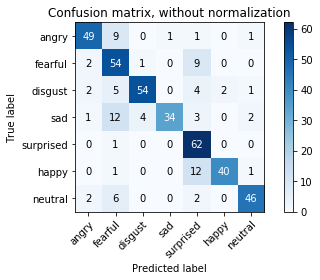

In [108]:
rf_class_female = RandomForestClassifier(n_estimators=100, max_depth=5, min_samples_split=3)
rf_class_female.fit(X_train_female,y_train_female)

various_scores(rf_class_female,X_train_female,y_train_female,'Train')
various_scores(rf_class_female,X_test_female,y_test_female,'Test')
plot_confusion_matrix((y_test_female),rf_class_female.predict(X_test_female),classes=list(df_combined_processed['emotion_desc'].unique()));

### LightGBM - Baseline

#### Male

Train  Data
######################################################
Accuracy : 97.48 %
______________________________________________________
              precision    recall  f1-score   support

       angry       0.99      0.97      0.98       262
     disgust       0.95      0.97      0.96       273
     fearful       0.99      0.96      0.98       266
       happy       0.98      0.97      0.97       267
     neutral       0.95      1.00      0.97       308
         sad       0.98      0.98      0.98       267
   surprised       0.99      0.97      0.98       265

    accuracy                           0.97      1908
   macro avg       0.98      0.97      0.97      1908
weighted avg       0.98      0.97      0.97      1908

______________________________________________________
Test  Data
######################################################
Accuracy : 85.85 %
______________________________________________________
              precision    recall  f1-score   support

       angry

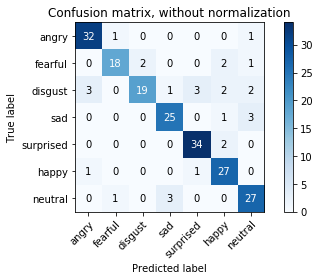

In [109]:
lgbm_class_male = LGBMClassifier(max_depth=3,num_leaves=10,objective='multiclass',random_state=209)
lgbm_class_male.fit(X_train_male,y_train_male)

various_scores(lgbm_class_male,X_train_male,y_train_male,'Train')
various_scores(lgbm_class_male,X_test_male,y_test_male,'Test')
plot_confusion_matrix((y_test_male),lgbm_class_male.predict(X_test_male),classes=list(df_combined_processed['emotion_desc'].unique()));

#### Female

Train  Data
######################################################
Accuracy : 99.17 %
______________________________________________________
              precision    recall  f1-score   support

       angry       1.00      0.99      0.99       235
     disgust       0.98      1.00      0.99       230
     fearful       1.00      0.98      0.99       228
       happy       0.99      1.00      0.99       240
     neutral       0.98      1.00      0.99       281
         sad       1.00      0.98      0.99       242
   surprised       1.00      1.00      1.00       240

    accuracy                           0.99      1696
   macro avg       0.99      0.99      0.99      1696
weighted avg       0.99      0.99      0.99      1696

______________________________________________________
Test  Data
######################################################
Accuracy : 86.08 %
______________________________________________________
              precision    recall  f1-score   support

       angry

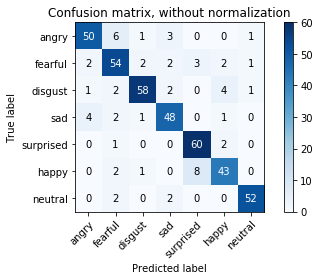

In [110]:
lgbm_class_female = LGBMClassifier(max_depth=3,num_leaves=10,objective='multiclass',random_state=209)
lgbm_class_female.fit(X_train_female,y_train_female)

various_scores(lgbm_class_female,X_train_female,y_train_female,'Train')
various_scores(lgbm_class_female,X_test_female,y_test_female,'Test')
plot_confusion_matrix((y_test_female),lgbm_class_female.predict(X_test_female),classes=list(df_combined_processed['emotion_desc'].unique()));

### LightGBM - RandomizedSearchCV

#### Male

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:   32.6s finished


{'polynomial__degree': 1, 'model__reg_lambda': 1, 'model__reg_alpha': 0.5, 'model__random_state': 209, 'model__objective': 'binary', 'model__num_leaves': 93, 'model__min_child_samples': 20, 'model__max_depth': 4, 'model__boosting_type': 'gbdt'}
Train  Data
######################################################
Accuracy : 99.48 %
______________________________________________________
              precision    recall  f1-score   support

       angry       1.00      1.00      1.00       262
     disgust       0.98      0.99      0.99       273
     fearful       1.00      0.99      0.99       266
       happy       1.00      1.00      1.00       267
     neutral       0.99      1.00      0.99       308
         sad       1.00      0.99      1.00       267
   surprised       1.00      0.99      0.99       265

    accuracy                           0.99      1908
   macro avg       1.00      0.99      0.99      1908
weighted avg       0.99      0.99      0.99      1908

_________________

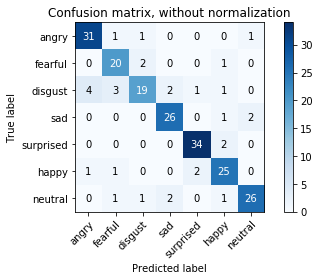

In [16]:
lgbm_grid_class_male = RandomizedSearchCV(estimator=lgbm_pipeline,
                             param_distributions=hyperparameters,
                             cv=3,
                             random_state=209,
                             scoring=scoring_list[3],
                             #n_iter=20,
                             verbose=1)
lgbm_grid_class_male.fit(X_train_male,y_train_male);
print(lgbm_grid_class_male.best_params_)

various_scores(lgbm_grid_class_male,X_train_male,y_train_male,'Train')
various_scores(lgbm_grid_class_male,X_test_male,y_test_male,'Test')
plot_confusion_matrix((y_test_male),lgbm_grid_class_male.predict(X_test_male),classes=list(df_combined_processed['emotion_desc'].unique()));


#### Female

Fitting 3 folds for each of 10 candidates, totalling 30 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:   19.6s finished


{'polynomial__degree': 1, 'model__reg_lambda': 0.5, 'model__reg_alpha': 0, 'model__random_state': 209, 'model__objective': 'binary', 'model__num_leaves': 93, 'model__min_child_samples': 3, 'model__max_depth': 4, 'model__boosting_type': 'gbdt'}
Train  Data
######################################################
Accuracy : 100.00 %
______________________________________________________
              precision    recall  f1-score   support

       angry       1.00      1.00      1.00       235
     disgust       1.00      1.00      1.00       230
     fearful       1.00      1.00      1.00       228
       happy       1.00      1.00      1.00       240
     neutral       1.00      1.00      1.00       281
         sad       1.00      1.00      1.00       242
   surprised       1.00      1.00      1.00       240

    accuracy                           1.00      1696
   macro avg       1.00      1.00      1.00      1696
weighted avg       1.00      1.00      1.00      1696

_________________

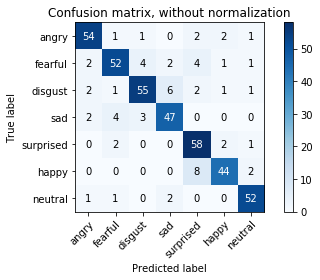

In [17]:
lgbm_grid_class_female = RandomizedSearchCV(estimator=lgbm_pipeline,
                             param_distributions=hyperparameters,
                             cv=3,
                             random_state=209,
                             scoring=scoring_list[3],
                             #n_iter=10,
                             verbose=1)
lgbm_grid_class_female.fit(X_train_female,y_train_female)
print(lgbm_grid_class_female.best_params_)

various_scores(lgbm_grid_class_female,X_train_female,y_train_female,'Train')
various_scores(lgbm_grid_class_female,X_test_female,y_test_female,'Test')
plot_confusion_matrix((y_test_female),lgbm_grid_class_female.predict(X_test_female),classes=list(df_combined_processed['emotion_desc'].unique()));

# 8. Test Model

### Convert .m4a to .wav format

In [82]:
formats_to_convert = ['.m4a']
# test_data youtube_test
folder = "test_data/"

for (dirpath, dirnames, filenames) in os.walk(folder):
    for filename in filenames:
        if filename.endswith(tuple(formats_to_convert)):

            filepath = dirpath + '/' + filename
            (path, file_extension) = os.path.splitext(filepath)
            file_extension_final = file_extension.replace('.', '')
            try:
                track = AudioSegment.from_file(filepath,
                        file_extension_final)
                wav_filename = filename.replace(file_extension_final, 'wav')
                wav_path = dirpath + '/' + wav_filename
                print('CONVERTING: ' + str(filepath))
                file_handle = track.export(wav_path, format='wav')
                os.remove(filepath)
            except:
                print("ERROR CONVERTING " + str(filepath))


### Gender & Emotion Classification

In [93]:
def process_test_data():
    # Load files to test
    test_data_folder_list = os.listdir(folder)
    if '.DS_Store' in test_data_folder_list:
        test_data_folder_list.remove('.DS_Store')
    test_data_folder_list = [folder+x for x in test_data_folder_list]

    # Create dataframe for test data
    df_test = pd.DataFrame({'filename':test_data_folder_list})

    # Process df_test and create ffted,mfcc,and etc...
    df_test_processed = df_preprocess(df_test)

    # Get features from df_test_processed
    X_test_pitch_stat = pd.DataFrame(list(df_test_processed['pitch_stat_from_rms']))
    X_test_pitch_extract = pd.DataFrame(list(df_test_processed['pitch_list']))
    X_test_pitch_mag_extract = pd.DataFrame(list(df_test_processed['pitch_mag_list']))
    X_test_rms_extract = pd.DataFrame(list(df_test_processed['rmsed']))
    X_test_mfcc = pd.DataFrame(list(df_test_processed['mfcc']))
    
    df_test_gender_multiple_features = pd.concat([X_test_pitch_stat,X_test_pitch_extract], axis=1)
    df_test_class_multiple_features = pd.concat([X_test_pitch_stat,X_test_pitch_extract,X_test_pitch_mag_extract,X_test_rms_extract,X_test_mfcc], axis=1)

    # For X_real_test, choose one of the top
    test_gender = df_test_gender_multiple_features
    test_class = df_test_class_multiple_features
    return test_gender,test_class,df_test_processed

def predict_gender_and_emotion(model_gender,model_class,data_gender, data_class,df_test_processed,gender_specific = True):
    pred_gender = model_gender.predict(data_gender)
    pred_gender_proba = model_gender.predict_proba(data_gender)
    pred_class = []
    for ix in range(len(data_class)):
        if gender_specific==True:
            if pred_gender[ix]=='male':
                pred_class.append(model_male_class.predict(data_class.iloc[[ix]]))
            else:
                pred_class.append(model_female_class.predict(data_class.iloc[[ix]]))
        else:
             pred_class.append(model_class.predict(data_class.iloc[[ix]]))
    for i in range(len(df_test_processed)):
        print('{}[{}] : {} - {}'.format(pred_gender[i],pred_gender_proba[i],pred_class[i],df_test_processed['filename'][i].split('/')[1].split('.')[0]))
        IPython.display.display(Audio(df_test_processed['stripped'][i],rate=22050))
        print('____________________')
        


In [94]:
test_gender,test_class,df_test_processed = process_test_data()
predict_gender_and_emotion(lgbm_grid_gender,lgbm_grid_class,test_gender,test_class,df_test_processed,False)

100%|██████████| 19/19 [00:08<00:00,  2.61it/s]

female[[0.98092251 0.01907749]] : ['neutral'] - eva_sad


____________________
female[[0.85414477 0.14585523]] : ['angry'] - benson_outlier


____________________
male[[0.03191139 0.96808861]] : ['neutral'] - low_matt


____________________
male[[0.40597713 0.59402287]] : ['neutral'] - eva


____________________
male[[0.11614776 0.88385224]] : ['neutral'] - danielo_wrong


____________________
female[[0.99872558 0.00127442]] : ['surprised'] - evahappy


____________________
female[[0.76991849 0.23008151]] : ['disgust'] - youtube


____________________
female[[0.9017544 0.0982456]] : ['sad'] - high_matt


____________________
female[[0.98465847 0.01534153]] : ['neutral'] - eva_sad2


____________________
female[[0.79998472 0.20001528]] : ['neutral'] - eva2


____________________
female[[0.97731677 0.02268323]] : ['surprised'] - eva3


____________________
female[[0.80788296 0.19211704]] : ['sad'] - danielo_2


____________________
female[[0.91724087 0.08275913]] : ['disgust'] - eva1


____________________
male[[0.07895391 0.92104609]] : ['sad'] - matt1


____________________
female[[0.91483732 0.08516268]] : ['disgust'] - valentina


____________________
male[[0.27565078 0.72434922]] : ['disgust'] - female


____________________
male[[0.41122988 0.58877012]] : ['happy'] - mick


____________________
female[[0.68084917 0.31915083]] : ['happy'] - evaangry


____________________
female[[0.71437341 0.28562659]] : ['disgust'] - jhonny


____________________
